# ITADAKI - Recipe Image Retrieval (avec Fine Tuning)
## EfficientNet Fine Tuning des 40 dernières couches pour retrouver les top-3 recettes similaires à partir d'une image

**Objectif**: 
- Tester l'extraction d'embedding et la recherche par similarité avec EfficientNet + Fine Tuning

**Bloc C5**:
- C1 : Préparer des données non structurées en les convertissant en données numériques et sous forme tabulaires pour servir de données d'entraînement à un algorithme d’apprentissage profond.
- C2 : Sélectionner l’algorithme d’apprentissage profond le plus adapté en comparant les performances et les caractéristiques des différentes familles d’algorithmes afin d'apporter une réponse pertinente adaptée à la problématique métier rencontrée.
- C3 : Entraîner un modèle d'apprentissage profond en optimisant une loss function (fonction de coût) à partir des données d’entraînement afin de permettre à l’algorithme d’effectuer le moins d’erreurs possibles selon des indicateurs de succès clairement définis.
- C4 : Déployer efficacement un modèle d'apprentissage profond en utilisant des outils et plateformes de production adaptés (MLOps), pour assurer une accessibilité et une performance optimale des prédictions de l'algorithme aux utilisateurs finaux.

---


In [8]:
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import os
import random
from PIL import Image
import re
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.metrics.pairwise import cosine_similarity
import warnings
warnings.filterwarnings('ignore')

# Style dark theme
plt.style.use('dark_background')
sns.set_palette("husl")

# Seeds pour reproductibilité
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

# HYPERPARAMETERS - Recipe Image Retrieval avec EfficientNet
CONFIG = {
    # === IMAGE PARAMETERS ===
    'IMG_SIZE': 224,                    # Optimal pour EfficientNet
    'BATCH_SIZE': 32,                   # Bon équilibre mémoire/performance
    
    # === EMBEDDING PARAMETERS ===
    'EMBEDDING_DIM_NATIVE': 1280,       # EfficientNet features natives
    'EMBEDDING_DIM_CUSTOM': 512,        # Custom head output (si fine-tuning)
    
    # === PHASE 1: FEATURE EXTRACTION ===
    'USE_NATIVE_FEATURES': True,        # True = 1280-dim, False = 512-dim custom
    
    # === PHASE 2: TRANSFER LEARNING ===
    'TRANSFER_EPOCHS': 15,              # Entraînement head seulement
    'TRANSFER_LR': 0.001,               # Learning rate plus élevé pour nouvelles couches
    'TRANSFER_BATCH_SIZE': 32,          # Plus petit pour stabilité
    
    # === PHASE 3: FINE-TUNING ===
    'FINETUNE_EPOCHS': 20,              # Fine-tuning complet
    'FINETUNE_LR': 0.0001,              # Learning rate faible pour pré-entraîné
    'FINETUNE_BATCH_SIZE': 16,          # Plus petit pour stabilité
    'FINETUNE_UNFREEZE_LAYERS': 20,     # Nombre de couches à dégeler
    
    # === TRAINING PARAMETERS ===
    'TRIPLET_MARGIN': 0.8,              # Augmenté pour meilleure séparation
    'DROPOUT_RATE': 0.3,                # Régularisation
    'WEIGHT_DECAY': 0.0001,             # L2 regularization
    
    # === OPTIMIZATION ===
    'OPTIMIZER': 'adam',                # Standard
    'PATIENCE': 3,                      # Early stopping
    'REDUCE_LR_PATIENCE': 2,            # Réduction LR
    'REDUCE_LR_FACTOR': 0.5,            # Facteur réduction
    
    # === DATA AUGMENTATION ===
    'USE_AUGMENTATION': True,           # Pour fine-tuning
    'ROTATION_RANGE': 15,               # Rotation aléatoire
    'ZOOM_RANGE': 0.1,                  # Zoom aléatoire
    'HORIZONTAL_FLIP': True,            # Flip horizontal
    
    # === EVALUATION ===
    'SIMILARITY_THRESHOLD': 0.7,       # Seuil similarité
    'TOP_K_RESULTS': 3,                 # Nombre résultats retournés
    'VALIDATION_SPLIT': 0.2,           # Split pour validation
}

# HYPERPARAMÈTRES Fine-Tuning
CONFIG_FT = {
    # === IMAGE PARAMETERS ===
    'IMG_SIZE': 224,                    # Optimal pour EfficientNet
    'BATCH_SIZE': 32,                   # Plus petit pour le fine-tuning si on fait du hard negative sampling
    'LAYERS_TO_UNFREEZE': 40,           # Nombre de couches à dégeler
    
    # === EMBEDDING PARAMETERS ===
    'EMBEDDING_DIM_NATIVE': 1280,       # EfficientNet features natives
    'EMBEDDING_DIM_CUSTOM': 512,        # Custom head output
    
    # === FINE-TUNING (TRIPLET) ===
    'HEAD_EPOCHS': 6,              # Entraînement head seulement (on a déjà testé et on a trouvé que c'est suffisant)
    'BACKBONE_EPOCHS': 20,         # Entraînement des couches dégelées
    'HEAD_LR': 0.001,                   # Entraînement avec triplet loss
    'BACKBONE_LR': 0.00001,             # Learning rate pour nouvelles couches
    'TRIPLET_MARGIN': 0.8,              # Marge triplet loss
    'DROPOUT_RATE': 0.3,                # Régularisation
    'WEIGHT_DECAY': 0.0001,             # L2 regularization
    
    # === OPTIMIZATION AVANCÉE ===
    'OPTIMIZER': 'adam',                # Standard
    'PATIENCE': 3,                      # Early stopping
    'REDUCE_LR_PATIENCE': 2,            # Réduction LR
    'REDUCE_LR_FACTOR': 0.5,            # Facteur réduction
    'MIN_LR': 1e-8,                     # LR minimum
    
    # === DATA AUGMENTATION ===
    'USE_AUGMENTATION': True,           # Augmentation
    'ROTATION_RANGE': 15,               # Rotation aléatoire
    'ZOOM_RANGE': 0.1,                  # Zoom aléatoire
    'BRIGHTNESS_RANGE': [0.9, 1.1],     # Luminosité
    'HORIZONTAL_FLIP': True,            # Flip horizontal
    
    # === VALIDATION & ÉVALUATION ===
    'VALIDATION_SPLIT': 0.2,           # Split pour validation
    'TOP_K_RESULTS': 3,                 # Nombre résultats
    'MIN_IMAGES_PER_RECIPE': 1,         # Filtrage minimum
    'MAX_PAIRS_PER_RECIPE': 5,          # Limite paires par recette
    
    # === MODÈLE ===
    'MODEL_NAME': 'recipe_image_retrieval_model_ft.keras',
    'EMBEDDINGS_NAME': 'recipe_embeddings_database_ft.npy',
    'METADATA_NAME': 'recipe_embeddings_database_metadata_ft.pkl'
}

print("Configuration adaptée pour EfficientNet Fine Tuning")
print(f"Phase 3: Fine-tuning ({CONFIG['EMBEDDING_DIM_CUSTOM']}-dim, {CONFIG['FINETUNE_EPOCHS']} epochs)")

print("Imports et configuration OK!")
print(f"TensorFlow: {tf.__version__}")
print(f"GPU: {tf.config.list_physical_devices('GPU')}")


Configuration adaptée pour EfficientNet Fine Tuning
Phase 3: Fine-tuning (512-dim, 20 epochs)
Imports et configuration OK!
TensorFlow: 2.19.0
GPU: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## 2. Couches personnalisées

In [9]:
from tensorflow.keras.layers import Layer

# COUCHE L2 NORMALIZATION PERSONNALISÉE (SÉRIALISABLE)
class L2NormalizationLayer(Layer):
    """Couche personnalisée pour normalisation L2 - sérialisable"""
    
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def compute_output_shape(self, input_shape):
        return input_shape
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config

# COUCHE EXTRACTION TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class ExtractTripletComponent(Layer):
    """Couche pour extraire une composante du triplet"""
    
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def compute_output_shape(self, input_shape):
        # input_shape = (batch_size, 3, height, width, channels)
        return (input_shape[0], input_shape[2], input_shape[3], input_shape[4])
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

# COUCHE STACK TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class TripletStackLayer(Layer):
    """Couche personnalisée pour empiler les embeddings triplet"""
    
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        # inputs = [anchor_emb, positive_emb, negative_emb]
        return tf.stack(inputs, axis=1)
    
    def compute_output_shape(self, input_shape):
        # input_shape = [(batch_size, embedding_dim), ...]
        batch_size = input_shape[0][0]
        embedding_dim = input_shape[0][1]
        return (batch_size, 3, embedding_dim)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

## 3. Gestion des triplets et de la triplet loss

In [10]:
#  FINE TUNING - Triplet Loss + EfficientNetB0
# ================================================================================
#  Triplet Loss (meilleur que Contrastive)
#  Architecture robuste + gestion d'erreurs  
#  Hyperparamètres avancés (weight decay, reduce LR, validation)
#  Callbacks pour l'entraînement

import os
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout, Layer
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, TensorBoard
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import preprocess_input
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.model_selection import train_test_split
import time
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

print(f"Configuration Fine-Tuning:")
print(f"- Taille des images: {CONFIG_FT['IMG_SIZE']}x{CONFIG_FT['IMG_SIZE']}")
print(f"- Taille du batch : {CONFIG_FT['BATCH_SIZE']}")
print(f"- Nb Epochs phase 1 (fixé à 6 car on connait sur autre notebook): {CONFIG_FT['HEAD_EPOCHS']}")
print(f"- Max Epochs phase 2: {CONFIG_FT['BACKBONE_EPOCHS']}")
print(f"- Learning Rate phase 1: {CONFIG_FT['HEAD_LR']}")
print(f"- Learning Rate phase 2: {CONFIG_FT['BACKBONE_LR']}")
print(f"- Embedding Dim: {CONFIG_FT['EMBEDDING_DIM_CUSTOM']} (custom)")
print(f"- Triplet Margin: {CONFIG_FT['TRIPLET_MARGIN']}")
print(f"- Dropout Rate: {CONFIG_FT['DROPOUT_RATE']}")
print(f"- Weight Decay: {CONFIG_FT['WEIGHT_DECAY']}")
print(f"- Early Stopping phase 2: {CONFIG_FT['PATIENCE']} epochs")

# PREPROCESSING
def preprocess_image(image_path, img_size=224):
    """Preprocessing robuste avec gestion d'erreurs complète + preprocessing natif EfficientNet"""
    try:
        if not os.path.exists(image_path):
            return None
        
        # Vérifier la taille du fichier (éviter fichiers corrompus)
        if os.path.getsize(image_path) < 1024:  # Moins de 1KB
            return None
        
        img = Image.open(image_path)
        
        # Vérifier si l'image est valide
        img.verify()
        img = Image.open(image_path)
        
        # Convertir en RGB si nécessaire
        if img.mode != 'RGB':
            img = img.convert('RGB')
        
        # Redimensionner avec qualité optimale
        img = img.resize((img_size, img_size), Image.Resampling.LANCZOS)
        
        # Convertir en array et appliquer preprocessing EfficientNet
        img_array = np.array(img, dtype=np.float32)
        # Normalisation EfficientNet native
        img_array = preprocess_input(img_array)  
        
        return img_array
        
    except Exception as e:
        return None
    
# TRIPLET LOSS AVEC EMBEDDINGS NORMALISÉS
def triplet_loss(margin=0.3):
    """Triplet loss avec embeddings L2-normalisés"""
    def triplet_loss_fn(y_true, y_pred):
        """
        y_pred contient [anchor, positive, negative] embeddings normalisés
        Utilise distance cosinus (1 - similarity) pour la loss
        """
        anchor = y_pred[:, 0, :]      # (batch_size, embedding_dim)
        positive = y_pred[:, 1, :]    # (batch_size, embedding_dim)
        negative = y_pred[:, 2, :]    # (batch_size, embedding_dim)
        
        # Calcul des distances cosinus (1 - similarité cosinus)
        # Pour embeddings normalisés: cosine_sim = dot_product
        pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
        neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
        
        pos_distance = 1.0 - pos_similarity
        neg_distance = 1.0 - neg_similarity
        
        # Triplet loss: max(0, pos_dist - neg_dist + margin)
        basic_loss = pos_distance - neg_distance + margin
        loss = tf.maximum(0.0, basic_loss)
        
        return tf.reduce_mean(loss)
    
    return triplet_loss_fn

# visualisation des triplets
def show_triplets(generator, n_triplets=10, title=None):
    """Affiche n triplets (anchor, positive, negative) depuis un batch du générateur"""
    
    try:
        # Générer un batch de triplets
        triplet_batch, _ = generator._generate_triplet_batch()
        
        print(f"Format du batch triplet: {triplet_batch.shape}")
        
        # Extraire les anchors, positives, negatives
        anchors = triplet_batch[:, 0, :, :, :]
        positives = triplet_batch[:, 1, :, :, :]
        negatives = triplet_batch[:, 2, :, :, :]
        
        n_triplets = min(n_triplets, len(anchors))
        
    except Exception as e:
        print(f"Erreur lors de la génération du batch: {e}")
        return

    def normalize_image_efficientnet(img):
        """Normalise l'image EfficientNet pour l'affichage"""
        if hasattr(img, 'numpy'):
            img = img.numpy()
        
        # Copier pour éviter de modifier l'original
        img = np.copy(img)
        
        # EfficientNet preprocess_input utilise une normalisation spécifique
        # Les valeurs sont généralement dans [-1, 1] ou [-2, 2]
        
        # Méthode 1: Normalisation standard
        img_min = img.min()
        img_max = img.max()
        
        if img_max > img_min:
            img = (img - img_min) / (img_max - img_min)
        else:
            # Image uniforme, mettre à 0.5
            img = np.full_like(img, 0.5)
        
        return np.clip(img, 0, 1)

    # Calculer les statistiques de difficulté
    print(f"\n=== ANALYSE DE LA DIFFICULTÉ DES TRIPLETS ===")
    
    difficulties = []
    for i in range(min(5, n_triplets)):
        anchor = anchors[i]
        positive = positives[i]
        negative = negatives[i]
        
        # Calculer les distances L2
        pos_dist = np.mean((anchor - positive) ** 2)
        neg_dist = np.mean((anchor - negative) ** 2)
        
        difficulty_ratio = neg_dist / (pos_dist + 1e-8)
        difficulties.append(difficulty_ratio)
        
        print(f"Triplet {i+1}:")
        print(f"- Distance anchor-positive: {pos_dist:.4f}")
        print(f"- Distance anchor-negative: {neg_dist:.4f}")
        print(f"- Ratio difficulté: {difficulty_ratio:.2f} {'(FACILE)' if difficulty_ratio > 3 else '(DIFFICILE)'}")
    
    avg_difficulty = np.mean(difficulties)
    print(f"\nDifficulté moyenne: {avg_difficulty:.2f}")
    print(f"Évaluation: {'TRIPLETS TROP FACILES' if avg_difficulty > 3 else 'TRIPLETS APPROPRIÉS'}")
    
    # Affichage visuel
    plt.figure(figsize=(12, 4 * n_triplets))
    
    for i in range(n_triplets):
        for j, (img, label) in enumerate([(anchors[i], "Anchor"), 
                                         (positives[i], "Positive"), 
                                         (negatives[i], "Negative")]):
            plt.subplot(n_triplets, 3, i * 3 + j + 1)
            
            try:
                # Utiliser la nouvelle fonction de normalisation
                normalized_img = normalize_image_efficientnet(img)
                
                # Debug: afficher les stats de l'image
                print(f"Image {i+1}-{label}: min={img.min():.3f}, max={img.max():.3f}, mean={img.mean():.3f}")
                print(f"Normalisée: min={normalized_img.min():.3f}, max={normalized_img.max():.3f}")
                
                plt.imshow(normalized_img)
                plt.axis('off')
                plt.title(f"{label}")
                
                # Ajouter info de difficulté pour le premier triplet
                if i == 0 and j == 0:
                    plt.xlabel(f"Difficulté: {difficulties[0]:.2f}")
                    
            except Exception as e:
                print(f"Erreur affichage image {i+1}-{label}: {e}")
                plt.text(0.5, 0.5, f"Erreur: {str(e)[:50]}", 
                        ha='center', va='center', transform=plt.gca().transAxes)
                plt.axis('off')
    
    if title:
        plt.suptitle(title, fontsize=16)
    else:
        plt.suptitle(f"Triplets - Difficulté moyenne: {avg_difficulty:.2f}", fontsize=16)
    
    plt.tight_layout()
    plt.show()

# GÉNÉRATEUR DE TRIPLETS
class TripletGenerator(tf.keras.utils.Sequence):
    """Générateur de triplets avec validation et augmentation avancée"""
    
    def __init__(self, recipes_df, batch_size=32, img_size=224, augment=True, validation_split=0.2, is_validation=False):
        self.batch_size = batch_size
        self.img_size = img_size
        self.augment = augment and not is_validation
        self.is_validation = is_validation
        
        # Filtrer et diviser les données
        self.valid_recipes = self._filter_valid_recipes(recipes_df)
        self.train_recipes, self.val_recipes = self._split_data(validation_split)
        
        # Utiliser le bon subset
        self.recipes_df = self.val_recipes if is_validation else self.train_recipes
        
        # Grouper par titre de recette
        self.recipe_groups = self.recipes_df.groupby('Title')
        self.recipe_names = list(self.recipe_groups.groups.keys())
        
        # Configuration augmentation de données
        if self.augment:
            self.datagen = ImageDataGenerator(
                rotation_range=CONFIG_FT['ROTATION_RANGE'],
                width_shift_range=0.1,
                height_shift_range=0.1,
                horizontal_flip=CONFIG_FT['HORIZONTAL_FLIP'],
                zoom_range=CONFIG_FT['ZOOM_RANGE'],
                brightness_range=CONFIG_FT['BRIGHTNESS_RANGE'],
                fill_mode='nearest'
            )
        
        self.on_epoch_end()
        
        split_name = "Validation" if is_validation else "Entraînement"
        print(f"Générateur {split_name} créé:")
        print(f"- Recettes: {len(self.recipe_names)}")
        print(f"- Images: {len(self.recipes_df)}")
        print(f"- Augmentation: {'Activée' if self.augment else 'Désactivée'}")
    
    def _filter_valid_recipes(self, recipes_df):
        """Filtrer les recettes avec images valides"""
        valid_recipes = []
        
        print("Filtrage des images valides...")
        for idx, row in tqdm(recipes_df.iterrows(), total=len(recipes_df), desc="Validation images"):
            if pd.notna(row['image_path']) and os.path.exists(row['image_path']):
                try:
                    img = Image.open(row['image_path'])
                    img.verify()
                    valid_recipes.append(row)
                except:
                    continue
        
        result_df = pd.DataFrame(valid_recipes)
        print(f"{len(result_df)}/{len(recipes_df)} images valides")
        return result_df
    
    def _split_data(self, validation_split):
        """Diviser les données en train/validation par recette"""
        unique_recipes = self.valid_recipes['Title'].unique()
        
        train_recipes, val_recipes = train_test_split(
            unique_recipes, 
            test_size=validation_split, 
            random_state=42
        )
        
        train_df = self.valid_recipes[self.valid_recipes['Title'].isin(train_recipes)]
        val_df = self.valid_recipes[self.valid_recipes['Title'].isin(val_recipes)]
        
        return train_df, val_df
    
    def __len__(self):
        return max(1, len(self.recipes_df) // self.batch_size)
    
    def __getitem__(self, index):
        return self._generate_triplet_batch()
    
    def on_epoch_end(self):
        """Mélanger les données à chaque époque"""
        pass
    
    def _generate_triplet_batch(self):
        """Générer un batch de triplets avec gestion robuste des erreurs"""
        batch_size = self.batch_size
        
        anchors = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        positives = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        negatives = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        
        valid_triplets = 0
        attempts = 0
        # Plus de tentatives pour robustesse
        max_attempts = batch_size * 5 
        
        while valid_triplets < batch_size and attempts < max_attempts:
            attempts += 1
            
            try:
                # Sélectionner une recette positive (avec au moins 1 image)
                pos_recipe = np.random.choice(self.recipe_names)
                pos_group = self.recipe_groups.get_group(pos_recipe)
                
                # Sélectionner une recette négative différente
                available_neg_recipes = [r for r in self.recipe_names if r != pos_recipe]
                if not available_neg_recipes:
                    continue
                    
                neg_recipe = np.random.choice(available_neg_recipes)
                neg_group = self.recipe_groups.get_group(neg_recipe)
                
                # Sélectionner les images du triplet
                if len(pos_group) >= 2:
                    # Cas idéal: 2 images différentes de la même recette
                    anchor_row, pos_row = pos_group.sample(2).iloc
                else:
                    # Cas limite: même image pour anchor et positive
                    anchor_row = pos_row = pos_group.iloc[0]
                
                # Image négative d'une recette différente
                neg_row = neg_group.sample(1).iloc[0]
                
                # Charger et préprocesser les images
                anchor_img = preprocess_image(anchor_row['image_path'], self.img_size)
                pos_img = preprocess_image(pos_row['image_path'], self.img_size)
                neg_img = preprocess_image(neg_row['image_path'], self.img_size)
                
                # Vérifier que toutes les images sont valides
                if anchor_img is not None and pos_img is not None and neg_img is not None:
                    
                    # Appliquer l'augmentation de données
                    if self.augment:
                        # Pas d'augmentation sur anchor et negative
                        pos_img = self.datagen.random_transform(pos_img)
                       
                    
                    # Ajouter au batch
                    anchors[valid_triplets] = anchor_img
                    positives[valid_triplets] = pos_img
                    negatives[valid_triplets] = neg_img
                    
                    valid_triplets += 1
                    
            except Exception as e:
                print(f"Erreur sur un triplet: {e}")
                continue
        
        # Compléter avec des copies si nécessaire (cas rare)
        while valid_triplets < batch_size:
            print(f"Pas assez de triplets valides: {valid_triplets}")
            copy_idx = np.random.randint(0, max(1, valid_triplets))
            anchors[valid_triplets] = anchors[copy_idx]
            positives[valid_triplets] = positives[copy_idx]  
            negatives[valid_triplets] = negatives[copy_idx]
            valid_triplets += 1
        
        # Format pour le modèle triplet: (batch_size, 3, height, width, channels)
        triplet_batch = np.stack([anchors, positives, negatives], axis=1)
        dummy_labels = np.zeros((batch_size, 1))  # Non utilisé avec triplet loss
        
        return triplet_batch, dummy_labels

class HardTripletGenerator(TripletGenerator):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.embedding_cache = {}
        self.update_frequency = 50  # Recalculer tous les 50 batches
        self.batch_count = 0
    
    def _select_hard_negative(self, pos_recipe, anchor_row):
        """Sélectionne un negative difficile"""
        # Pour l'instant, sélection aléatoire (à améliorer avec embeddings)
        available_neg_recipes = [r for r in self.recipe_names if r != pos_recipe]
        
        # TODO: Améliorer avec similarité des embeddings
        # Pour l'instant, on fait du random
        return np.random.choice(available_neg_recipes)
    
    def _strong_augmentation(self, img):
        """Augmentation plus forte pour rendre les positives plus difficiles"""
        # Attention: img est déjà normalisé par EfficientNet preprocess_input
        # Les valeurs sont dans [-1, 1] environ
        
        # Augmentation normale d'abord
        img = self.datagen.random_transform(img)
        
        # Augmentations supplémentaires légères
        if np.random.random() < 0.3:
            # Bruit gaussien très léger
            noise = np.random.normal(0, 0.02, img.shape)
            img = img + noise
        
        if np.random.random() < 0.2:
            # Légère modification de contraste
            img = img * np.random.uniform(0.95, 1.05)
        
        return img
    
    def _generate_triplet_batch(self):
        """Générer un batch de triplets avec gestion robuste des erreurs"""
        batch_size = self.batch_size
        
        anchors = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        positives = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        negatives = np.zeros((batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        
        valid_triplets = 0
        attempts = 0
        # Plus de tentatives pour robustesse
        max_attempts = batch_size * 5 
        
        while valid_triplets < batch_size and attempts < max_attempts:
            attempts += 1
            
            try:
                # Sélectionner une recette positive (avec au moins 1 image)
                pos_recipe = np.random.choice(self.recipe_names)
                pos_group = self.recipe_groups.get_group(pos_recipe)
                
                # Sélectionner une recette négative différente
                available_neg_recipes = [r for r in self.recipe_names if r != pos_recipe]
                if not available_neg_recipes:
                    continue
                    
                neg_recipe = np.random.choice(available_neg_recipes)
                neg_group = self.recipe_groups.get_group(neg_recipe)
                
                # Sélectionner les images du triplet
                if len(pos_group) >= 2:
                    # Cas idéal: 2 images différentes de la même recette
                    anchor_row, pos_row = pos_group.sample(2).iloc
                else:
                    # Cas limite: même image pour anchor et positive
                    anchor_row = pos_row = pos_group.iloc[0]
                
                # Image négative d'une recette différente
                neg_row = neg_group.sample(1).iloc[0]
                
                # Charger et préprocesser les images
                anchor_img = preprocess_image(anchor_row['image_path'], self.img_size)
                pos_img = preprocess_image(pos_row['image_path'], self.img_size)
                neg_img = preprocess_image(neg_row['image_path'], self.img_size)
                
                # Vérifier que toutes les images sont valides
                if anchor_img is not None and pos_img is not None and neg_img is not None:
                    
                    # Appliquer l'augmentation de données
                    if self.augment:
                        # Pas d'augmentation sur anchor et negative
                        pos_img = self.datagen.random_transform(pos_img)
                       
                    
                    # Ajouter au batch
                    anchors[valid_triplets] = anchor_img
                    positives[valid_triplets] = pos_img
                    negatives[valid_triplets] = neg_img
                    
                    valid_triplets += 1
                    
            except Exception as e:
                print(f"Erreur sur un triplet: {e}")
                continue
        
        # Compléter avec des copies si nécessaire (cas rare)
        while valid_triplets < batch_size:
            print(f"Pas assez de triplets valides: {valid_triplets}")
            copy_idx = np.random.randint(0, max(1, valid_triplets))
            anchors[valid_triplets] = anchors[copy_idx]
            positives[valid_triplets] = positives[copy_idx]  
            negatives[valid_triplets] = negatives[copy_idx]
            valid_triplets += 1
        
        # Format pour le modèle triplet: (batch_size, 3, height, width, channels)
        triplet_batch = np.stack([anchors, positives, negatives], axis=1)
        dummy_labels = np.zeros((batch_size, 1))  # Non utilisé avec triplet loss
        
        return triplet_batch, dummy_labels
        
# MODÈLE TRIPLET POUR ENTRAÎNEMENT
def create_triplet_model(embedding_model):
   
    """Modèle triplet avec couches personnalisées sérialisables"""

    # Input: batch de triplets (batch_size, 3, height, width, channels)
    triplet_input = tf.keras.layers.Input(
        shape=(3, CONFIG_FT['IMG_SIZE'], CONFIG_FT['IMG_SIZE'], 3),
        name='triplet_input'
    )
    
    anchor = ExtractTripletComponent(0, name='extract_anchor')(triplet_input)
    positive = ExtractTripletComponent(1, name='extract_positive')(triplet_input)
    negative = ExtractTripletComponent(2, name='extract_negative')(triplet_input)
    
    # Obtenir les embeddings normalisés
    anchor_emb = embedding_model(anchor)
    positive_emb = embedding_model(positive)
    negative_emb = embedding_model(negative)
    
    triplet_output = TripletStackLayer(name='combine_embeddings')([anchor_emb, positive_emb, negative_emb])
    
    model = Model(inputs=triplet_input, outputs=triplet_output, name='TransferLearningTripletModel')
    
    print(f"Modèle triplet créé:")
    print(f"- Input shape: {model.input_shape}")
    print(f"- Output shape: {model.output_shape}")
    
    return model

# MÉTRIQUES
def triplet_margin_accuracy(y_true, y_pred):
    """% de triplets qui respectent la marge complète (vraie réussite)"""
    anchor = y_pred[:, 0, :]
    positive = y_pred[:, 1, :]
    negative = y_pred[:, 2, :]
    
    pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
    neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
    
    # Distance cosinus
    pos_distance = 1.0 - pos_similarity
    neg_distance = 1.0 - neg_similarity
    
    # Triplet satisfait si : neg_dist - pos_dist > margin
    margin = CONFIG_FT['TRIPLET_MARGIN']  # Utiliser la marge configurée
    margin_satisfied = tf.cast(neg_distance - pos_distance > margin, tf.float32)
    
    return tf.reduce_mean(margin_satisfied)

def average_positive_similarity(y_true, y_pred):
    """Similarité moyenne anchor-positive"""
    anchor = y_pred[:, 0, :]
    positive = y_pred[:, 1, :]
    pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
    return tf.reduce_mean(pos_similarity)

def average_negative_similarity(y_true, y_pred):
    """Similarité moyenne anchor-negative"""
    anchor = y_pred[:, 0, :]
    negative = y_pred[:, 2, :]
    neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
    return tf.reduce_mean(neg_similarity)

Configuration Fine-Tuning:
- Taille des images: 224x224
- Taille du batch : 32
- Nb Epochs phase 1 (fixé à 6 car on connait sur autre notebook): 6
- Max Epochs phase 2: 20
- Learning Rate phase 1: 0.001
- Learning Rate phase 2: 1e-05
- Embedding Dim: 512 (custom)
- Triplet Margin: 0.8
- Dropout Rate: 0.3
- Weight Decay: 0.0001
- Early Stopping phase 2: 3 epochs


## 4. Phase 1 : Transfer Learning (entraînement de la tête)

In [11]:
# MODELE PHASE 1
def create_embedding_model_phase1(embedding_dim=512):
    """Modèle d'embedding pour entrainer la tête uniquement avec triplet loss"""
    
     # Base EfficientNetB0
    base_model = EfficientNetB0(
        weights='imagenet',
        include_top=False,
        input_shape=(CONFIG_FT['IMG_SIZE'], CONFIG_FT['IMG_SIZE'], 3)
    )
    
    # Geler toutes les couches d'abord
    for layer in base_model.layers:
        layer.trainable = False
      
    # Custom head
    x = base_model.output
    x = GlobalAveragePooling2D(name='global_avg_pool')(x)
    embeddings = Dense(embedding_dim, activation=None, name='embeddings')(x)

    # Normalisation L2 pour ce soit compatible avec triplet loss + similarité cosinus
    embeddings_normalized = L2NormalizationLayer(axis=1, name='l2_norm')(embeddings)
    
    # Modèle final
    model = Model(inputs=base_model.input, outputs=embeddings_normalized, name='TransferLearningEmbeddingModel')

    # Afficher le résumé (décommenter si besoin de voir les couches)
    # model.summary()
    
    print(f"Modèle d'embedding phase 1 créé:")
    print(f"- Params totaux: {model.count_params():,}")
    print(f"- Params entraînables: {sum([tf.size(w) for w in model.trainable_weights]):,}")
    print(f"- Architecture: EfficientNetB0 + Fine Tuning, phase 1 ({embedding_dim}D)")
    
    return model

# FONCTION D'ENTRAÎNEMENT PHASE 1
def train_transfer_learning_phase1():
    """Entraînement complet avec toutes les optimisations"""
    
    print("Début de l'entraînement Fine-Tuning phase 1...")
    print("=" * 60)
    
    # Charger les données
    try:
        recipes_df = pd.read_pickle("./data/recipes_with_images_dataframe.pkl")
        print(f"{len(recipes_df)} recettes chargées depuis le DataFrame")
    except FileNotFoundError:
        print("Fichier ./data/recipes_with_images_dataframe.pkl introuvable")
        print("Assurez-vous d'avoir exécuté le notebook 'raw' qui génère le DataFrame sous forme de pickle")
        return None, None
    
    # Créer le modèle d'embedding phase 1 
    print("\nCréation du modèle d'embedding phase 1...")
    embedding_model_phase1 = create_embedding_model_phase1(
        embedding_dim=CONFIG_FT['EMBEDDING_DIM_CUSTOM']
    )

    # Créer les générateurs de données (train + validation)
    print("\nCréation des générateurs de données...")
    train_generator = HardTripletGenerator(
        recipes_df,
        batch_size=CONFIG_FT['BATCH_SIZE'],
        img_size=CONFIG_FT['IMG_SIZE'],
        augment=CONFIG_FT['USE_AUGMENTATION'],
        validation_split=CONFIG_FT['VALIDATION_SPLIT'],
        is_validation=False
    )

    val_generator = HardTripletGenerator(
        recipes_df,
        batch_size=CONFIG_FT['BATCH_SIZE'],
        img_size=CONFIG_FT['IMG_SIZE'],
        augment=False,  # Pas d'augmentation en validation
        validation_split=CONFIG_FT['VALIDATION_SPLIT'],
        is_validation=True
    )

    # Créer le modèle triplet phase 1
    triplet_model_phase1 = create_triplet_model(embedding_model_phase1)

    # Compiler le modèle phase 1 entrainement de la tête uniquement
    triplet_model_phase1.compile(
        optimizer=Adam(
            learning_rate=CONFIG_FT['HEAD_LR'],
            weight_decay=CONFIG_FT['WEIGHT_DECAY']
        ),
        loss=triplet_loss(margin=CONFIG_FT['TRIPLET_MARGIN']),
        metrics=[triplet_margin_accuracy, average_positive_similarity, average_negative_similarity]
    )
    
    print(f"Modèle phase 1 compilé (entrainement de la tête uniquement):")
    print(f"- Optimizer: Adam (lr={CONFIG_FT['HEAD_LR']}, wd={CONFIG_FT['WEIGHT_DECAY']})")
    print(f"- Loss: Triplet Loss (margin={CONFIG_FT['TRIPLET_MARGIN']})")
    print(f"- Métriques: Accuracy + Similarités moyenne")

    # CALLBACK PERSONNALISÉ pour adapter le margin de triplet loss
    class AdaptiveMarginCallback(tf.keras.callbacks.Callback):
        def __init__(self, initial_margin=CONFIG_FT['TRIPLET_MARGIN']):
            self.margin = initial_margin
        
        def on_epoch_end(self, epoch, logs=None):
            triplet_acc = logs.get('triplet_margin_accuracy', 0)
            
            if triplet_acc > 0.95:  # Trop facile
                self.margin += 0.1
                print(f"Augmentation margin à {self.margin}")
            elif triplet_acc < 0.7:  # Trop difficile
                self.margin -= 0.05
                print(f"Réduction margin à {self.margin}")

    # Callbacks pour l'entraînement phase 1
    callbacks_phase1= [
        ReduceLROnPlateau(
            monitor='val_loss',
            patience=CONFIG_FT['REDUCE_LR_PATIENCE'],
            factor=CONFIG_FT['REDUCE_LR_FACTOR'],
            min_lr=CONFIG_FT['MIN_LR'],
            verbose=1,
            mode='min'
        ),
        AdaptiveMarginCallback(initial_margin=CONFIG_FT['TRIPLET_MARGIN']),
    ]

    print(f"6 époques fixées pour l'entraînement phase 1 car on a déjà testé et on a trouvé que c'est suffisant")
    print(f"Callbacks configurés pour phase 1:")
    print(f"- Reduce LR: patience={CONFIG_FT['REDUCE_LR_PATIENCE']}, factor={CONFIG_FT['REDUCE_LR_FACTOR']}")
    print(f"- Adaptive Margin: initial={CONFIG_FT['TRIPLET_MARGIN']}")
    
    # Entraînement
    start_time_phase1 = time.time()

    print("\nEntraînement phase 1...")
    
    history_phase1 = triplet_model_phase1.fit(
        train_generator,
        epochs=CONFIG_FT['HEAD_EPOCHS'],
        validation_data=val_generator,
        callbacks=callbacks_phase1,
        verbose=1
    )
    
    training_time_phase1 = time.time() - start_time_phase1 
    
    # Afficher les résultats
    print("\n" + "="*60)
    print(" ENTRAÎNEMENT PHASE 1 TERMINÉ AVEC SUCCÈS!")
    print("="*60)
    print(f"⏱ Temps total: {training_time_phase1    /60:.1f} minutes")
    print(f" Meilleure val_loss: {min(history_phase1.history['val_loss']):.4f}")
    print(f" Précision finale: {history_phase1.history['val_triplet_margin_accuracy'][-1]:.4f}")
    print(f" Similarité pos finale: {history_phase1.history['val_average_positive_similarity'][-1]:.4f}")
    print(f" Similarité neg finale: {history_phase1.history['val_average_negative_similarity'][-1]:.4f}")

    return embedding_model_phase1, history_phase1

## 5. Phase 2 : Fine-Tuning (entraînement des couches dégelées)

In [12]:
def create_embedding_model_phase2(embedding_model_phase1, embedding_dim=512):
    """Modèle d'embedding phase 2 avec fine-tuning (dégel partiel du backbone)"""
    
    print(f"Total des couches EfficientNet + custom head: {len(embedding_model_phase1.layers)}")

    # Exclure les 5 dernières couches (la tête custom)
    head_size = 5
    backbone_layers = embedding_model_phase1.layers[:-head_size]

    layers_to_unfreeze = CONFIG_FT['LAYERS_TO_UNFREEZE']
    print(f"Dégel des {layers_to_unfreeze} dernières couches du backbone...")

    # Dégeler les N dernières couches du backbone
    for layer in backbone_layers[-layers_to_unfreeze:]:
        layer.trainable = True

    # Statistiques (backbone uniquement)
    frozen_layers = sum([1 for layer in backbone_layers if not layer.trainable])
    trainable_layers = sum([1 for layer in backbone_layers if layer.trainable])
    
    print(f"Couches gelées dans le backbone: {frozen_layers}")
    print(f"Couches dégelées dans le backbone: {trainable_layers} (sur {len(backbone_layers)})")

    print(f"Modèle d'embedding phase 2 créé:")
    print(f"- Params totaux: {embedding_model_phase1.count_params():,}")
    print(f"- Params entraînables: {sum([tf.size(w) for w in embedding_model_phase1.trainable_weights]):,}")
    print(f"- Architecture: EfficientNetB0 + Fine Tuning ({embedding_dim}D)")

    return embedding_model_phase1

def train_fine_tuning_phase2(embedding_model_phase1):
    """Entraînement complet avec toutes les optimisations"""
    
    print("Début de l'entraînement Fine-Tuning phase 2...")
    print("=" * 60)
    
    # Charger les données
    try:
        recipes_df = pd.read_pickle("./data/recipes_with_images_dataframe.pkl")
        print(f"{len(recipes_df)} recettes chargées depuis le DataFrame")
    except FileNotFoundError:
        print("Fichier ./data/recipes_with_images_dataframe.pkl introuvable")
        print("Assurez-vous d'avoir exécuté le notebook 'raw' qui génère le DataFrame sous forme de pickle")
        return None, None
    
    print("\nCréation du modèle d'embedding phase 2...")
    embedding_model_phase2 = create_embedding_model_phase2(
        embedding_model_phase1,
        embedding_dim=CONFIG_FT['EMBEDDING_DIM_CUSTOM']
    )
    
    # Créer les générateurs de données (train + validation)
    print("\nCréation des générateurs de données...")
    train_generator = TripletGenerator(
        recipes_df,
        batch_size=CONFIG_FT['BATCH_SIZE'],
        img_size=CONFIG_FT['IMG_SIZE'],
        augment=CONFIG_FT['USE_AUGMENTATION'],
        validation_split=CONFIG_FT['VALIDATION_SPLIT'],
        is_validation=False
    )

    show_triplets(train_generator, n_triplets=10, title="Triplets train")
    
    val_generator = TripletGenerator(
        recipes_df,
        batch_size=CONFIG_FT['BATCH_SIZE'],
        img_size=CONFIG_FT['IMG_SIZE'],
        augment=False,  # Pas d'augmentation en validation
        validation_split=CONFIG_FT['VALIDATION_SPLIT'],
        is_validation=True
    )

    show_triplets(val_generator, n_triplets=10, title="Triplets val")
    
    # Créer le modèle triplet phase 2
    triplet_model_phase2 = create_triplet_model(embedding_model_phase2)

    # Compiler le modèle phase 2 entrainement des couches dégelées
    triplet_model_phase2.compile(
        optimizer=Adam(
            learning_rate=CONFIG_FT['BACKBONE_LR'],
            weight_decay=CONFIG_FT['WEIGHT_DECAY']
        ),
        loss=triplet_loss(margin=CONFIG_FT['TRIPLET_MARGIN']),
        metrics=[triplet_margin_accuracy, average_positive_similarity, average_negative_similarity]
    )
    
    print(f"Modèle phase 2 compilé (entrainement des couches dégelées):")
    print(f"- Optimizer: Adam (lr={CONFIG_FT['BACKBONE_LR']}, wd={CONFIG_FT['WEIGHT_DECAY']})")
    print(f"- Loss: Triplet Loss (margin={CONFIG_FT['TRIPLET_MARGIN']})")
    print(f"- Métriques: Accuracy + Similarités moyenne")

    # CALLBACK PERSONNALISÉ pour adapter le margin de triplet loss
    class AdaptiveMarginCallback(tf.keras.callbacks.Callback):
        def __init__(self, initial_margin=CONFIG_FT['TRIPLET_MARGIN']):
            self.margin = initial_margin
        
        def on_epoch_end(self, epoch, logs=None):
            triplet_acc = logs.get('triplet_margin_accuracy', 0)
            
            if triplet_acc > 0.95:  # Trop facile
                self.margin += 0.1
                print(f"Augmentation margin à {self.margin}")
            elif triplet_acc < 0.7:  # Trop difficile
                self.margin -= 0.05
                print(f"Réduction margin à {self.margin}")

    # CALLBACK PERSONNALISÉ pour sauvegarder UNIQUEMENT l'embedding model (et pas le triplet model)
    class EmbeddingModelCheckpoint(tf.keras.callbacks.Callback):
        """
        Callback personnalisé qui sauvegarde l'embedding model (pas le triplet model)
        C'est CRUCIAL car ModelCheckpoint standard sauvegarderait le triplet model !
        """
        def __init__(self, embedding_model, filepath, monitor='val_loss', save_best_only=True, verbose=1):
            super().__init__()
            self.embedding_model = embedding_model  # Le modèle qui nous intéresse
            self.filepath = filepath
            self.monitor = monitor
            self.save_best_only = save_best_only
            self.verbose = verbose
            self.best_value = np.inf if 'loss' in monitor else -np.inf
            
        def on_epoch_end(self, epoch, logs=None):
            current_value = logs.get(self.monitor)
            if current_value is None:
                if self.verbose > 0:
                    print(f"\n Métrique '{self.monitor}' non trouvée dans les logs")
                return
                
            improved = False
            if 'loss' in self.monitor or 'error' in self.monitor:
                # Pour les métriques à minimiser
                if current_value < self.best_value:
                    self.best_value = current_value
                    improved = True
            else:
                # Pour les métriques à maximiser (accuracy, etc.)
                if current_value > self.best_value:
                    self.best_value = current_value
                    improved = True
                    
            if improved or not self.save_best_only:
                try:
                    #  SAUVEGARDER L'EMBEDDING MODEL si amélioration (pas le triplet model)
                    if improved:
                        self.embedding_model.save(self.filepath)
                        print(f"\nNOUVEAU MEILLEUR MODELE D'EMBEDDINGS sauvegardé!")
                        print(f"Fichier: {self.filepath}")
                        print(f"{self.monitor}: {current_value:.4f}")
                    else:
                        print(f"\nPas d'amélioration du modèle d'embeddings")
                            
                except Exception as e:
                    if self.verbose > 0:
                        print(f"\nErreur sauvegarde embedding model: {e}")
                        
        def on_train_end(self, logs=None):
            if self.verbose > 0:
                print(f"\nEntraînement terminé. Meilleur {self.monitor}: {self.best_value:.4f}")
                print(f"Meilleur embedding model disponible: {self.filepath}")
    
    callbacks_phase2 = [
        EarlyStopping(
            monitor='val_loss',
            patience=CONFIG_FT['PATIENCE'],
            restore_best_weights=True,
            verbose=1,
            mode='min'
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            patience=CONFIG_FT['REDUCE_LR_PATIENCE'],
            factor=CONFIG_FT['REDUCE_LR_FACTOR'],
            min_lr=CONFIG_FT['MIN_LR'],
            verbose=1,
            mode='min'
        ),
        ModelCheckpoint(
            f"./ft/best_triplet_{CONFIG_FT['MODEL_NAME']}",
            monitor='val_loss',
            save_best_only=True,
            save_weights_only=False,
            verbose=1,
            mode='min'
        ),
        AdaptiveMarginCallback(initial_margin=CONFIG_FT['TRIPLET_MARGIN']),
        EmbeddingModelCheckpoint(
            embedding_model_phase2,
            f"./ft/best_embedding_{CONFIG_FT['MODEL_NAME']}",
            monitor='val_loss',
            save_best_only=True,
            verbose=1,
        ),
        TensorBoard(
            log_dir=f"./ft/logs/{CONFIG_FT['MODEL_NAME']}",
            histogram_freq=1,
            write_graph=True,
            write_images=True,
            update_freq='epoch',
            profile_batch=2,
            embeddings_freq=1
        )
    ]
    
    print(f"Callbacks configurés pour phase 2:")
    print(f"- Adaptive Margin: initial={CONFIG_FT['TRIPLET_MARGIN']}")
    print(f"- Early Stopping: patience={CONFIG_FT['PATIENCE']} (val_loss)")
    print(f"- Reduce LR: patience={CONFIG_FT['REDUCE_LR_PATIENCE']}, factor={CONFIG_FT['REDUCE_LR_FACTOR']}")
    print(f"- Model Checkpoint: best_{CONFIG_FT['MODEL_NAME']}")
    
    # Entraînement
    print("\n" + "="*60)
    print("DÉBUT DE L'ENTRAÎNEMENT")
    print("="*60)
    print(f"- Entraînement: {len(train_generator)} batch/époque")
    print(f"- Validation: {len(val_generator)} batch/époque")
    print(f"- Objectif: apprendre des embeddings discriminants via triplet loss")
    
    start_time_phase2 = time.time()

    print("\nEntraînement phase 2...")
    
    history_phase2 = triplet_model_phase2.fit(
        train_generator,
        epochs=CONFIG_FT['BACKBONE_EPOCHS'],
        validation_data=val_generator,
        callbacks=callbacks_phase2,
        verbose=1
    )
    
    training_time_phase2 = time.time() - start_time_phase2 
    
    # Afficher les résultats
    print("\n" + "="*60)
    print(" ENTRAÎNEMENT PHASE 2 TERMINÉ AVEC SUCCÈS!")
    print("="*60)
    print(f"⏱ Temps total: {training_time_phase2/60:.1f} minutes")
    print(f" Meilleure val_loss: {min(history_phase2.history['val_loss']):.4f}")
    print(f" Précision finale: {history_phase2.history['val_triplet_margin_accuracy'][-1]:.4f}")
    print(f" Similarité pos finale: {history_phase2.history['val_average_positive_similarity'][-1]:.4f}")
    print(f" Similarité neg finale: {history_phase2.history['val_average_negative_similarity'][-1]:.4f}")
    print(f" Modèle sauvegardé: {CONFIG_FT['MODEL_NAME']}")

    return embedding_model_phase2, history_phase2

## 6. Visualisation des résultats entraînement pour phase 2

In [13]:
def plot_training_results(history):
    """Afficher les métriques d'entraînement avec échelles adaptées"""
    
    # Vérifier que les métriques existent
    required_metrics = ['loss', 'val_loss', 'triplet_margin_accuracy', 'val_triplet_margin_accuracy']
    for metric in required_metrics:
        if metric not in history.history:
            print(f"Métrique manquante: {metric}")
            return
    
    # Configuration dark mode (identique)
    plt.style.use('dark_background')
    colors = {
        'primary': '#00D4AA',
        'secondary': '#FF6B6B', 
        'accent': '#4ECDC4',
        'warning': '#FFE66D',
        'info': '#A8E6CF',
        'purple': '#B19CD9'
    }
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.patch.set_facecolor('#1e1e1e')
    fig.suptitle('Résultats d\'Entraînement Fine-Tuning', 
                 fontsize=18, fontweight='bold', color='white', y=0.95)
    
    for ax in axes.flat:
        ax.set_facecolor('#2d2d2d')
        ax.tick_params(colors='white', which='both')
        ax.xaxis.label.set_color('white')
        ax.yaxis.label.set_color('white')
        ax.title.set_color('white')
        ax.grid(True, alpha=0.2, color='gray', linestyle='-', linewidth=0.5)
        for spine in ax.spines.values():
            spine.set_color('white')
    
    # Loss
    axes[0, 0].plot(history.history['loss'], label='Train Loss', 
                    linewidth=3, color=colors['primary'], alpha=0.9)
    axes[0, 0].plot(history.history['val_loss'], label='Val Loss', 
                    linewidth=3, color=colors['secondary'], alpha=0.9)
    axes[0, 0].fill_between(range(len(history.history['loss'])), 
                           history.history['loss'], alpha=0.1, color=colors['primary'])
    axes[0, 0].fill_between(range(len(history.history['val_loss'])), 
                           history.history['val_loss'], alpha=0.1, color=colors['secondary'])
    axes[0, 0].set_title('Triplet Loss Evolution', fontweight='bold', fontsize=14)
    axes[0, 0].set_xlabel('Époque', fontweight='bold')
    axes[0, 0].set_ylabel('Loss Value', fontweight='bold')
    axes[0, 0].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    
    # Accuracy
    axes[0, 1].plot(history.history['triplet_margin_accuracy'], label='Train Margin Accuracy', 
                    linewidth=3, color=colors['accent'], alpha=0.9)
    axes[0, 1].plot(history.history['val_triplet_margin_accuracy'], label='Val Margin Accuracy', 
                    linewidth=3, color=colors['warning'], alpha=0.9)
    axes[0, 1].axhline(y=0.8, color='white', linestyle='--', alpha=0.5, label='Target (80%)')
    axes[0, 1].set_title('Triplet Margin Accuracy Progress', fontweight='bold', fontsize=14)
    axes[0, 1].set_xlabel('Époque', fontweight='bold')
    axes[0, 1].set_ylabel('Margin Accuracy Score', fontweight='bold')
    axes[0, 1].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    axes[0, 1].set_ylim(0, 1)  # ✅ Parfait
    
    # Positive Similarity
    if 'average_positive_similarity' in history.history:
        axes[1, 0].plot(history.history['average_positive_similarity'], label='Train Pos Sim', 
                        linewidth=3, color=colors['info'], alpha=0.9)
        axes[1, 0].plot(history.history['val_average_positive_similarity'], label='Val Pos Sim', 
                        linewidth=3, color=colors['purple'], alpha=0.9)
        
        
        axes[1, 0].set_ylim(0, 1)
        axes[1, 0].axhspan(0.7, 1.0, alpha=0.1, color='green', label='Target Zone (>0.7)')
        axes[1, 0].axhline(y=0.7, color='white', linestyle='--', alpha=0.5)
        
    axes[1, 0].set_title('Positive Similarity (Anchor-Positive)', fontweight='bold', fontsize=14)
    axes[1, 0].set_xlabel('Époque', fontweight='bold')
    axes[1, 0].set_ylabel('Cosine Similarity', fontweight='bold')
    axes[1, 0].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    
    # Negative Similarity
    if 'average_negative_similarity' in history.history:
        axes[1, 1].plot(history.history['average_negative_similarity'], label='Train Neg Sim', 
                        linewidth=3, color=colors['secondary'], alpha=0.9)
        axes[1, 1].plot(history.history['val_average_negative_similarity'], label='Val Neg Sim', 
                        linewidth=3, color=colors['primary'], alpha=0.9)
        
        axes[1, 1].set_ylim(-0.5, 0.5) 
        axes[1, 1].axhspan(-0.5, 0.3, alpha=0.1, color='red', label='Target Zone (<0.3)')
        axes[1, 1].axhline(y=0.3, color='white', linestyle='--', alpha=0.5)
        
    axes[1, 1].set_title('Negative Similarity (Anchor-Negative)', fontweight='bold', fontsize=14)
    axes[1, 1].set_xlabel('Époque', fontweight='bold')
    axes[1, 1].set_ylabel('Cosine Similarity', fontweight='bold')
    axes[1, 1].legend(frameon=True, fancybox=True, shadow=True, 
                     facecolor='#3d3d3d', edgecolor='white')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    plt.style.use('default')
    
    # Résumé amélioré
    print("\nRÉSUMÉ DES MÉTRIQUES FINALES:")
    print("-" * 50)
    
    final_metrics = {}
    if 'val_loss' in history.history:
        final_metrics['Loss (validation)'] = history.history['val_loss'][-1]
    if 'val_triplet_margin_accuracy' in history.history:
        final_metrics['Margin Accuracy (validation)'] = history.history['val_triplet_margin_accuracy'][-1]
    if 'val_average_positive_similarity' in history.history:
        final_metrics['Similarité Positive'] = history.history['val_average_positive_similarity'][-1]
    if 'val_average_negative_similarity' in history.history:
        final_metrics['Similarité Négative'] = history.history['val_average_negative_similarity'][-1]
    
    # Calcul de l'écart seulement si les deux métriques existent
    if 'val_average_positive_similarity' in history.history and 'val_average_negative_similarity' in history.history:
        final_metrics['Écart Pos-Neg'] = (history.history['val_average_positive_similarity'][-1] - 
                                          history.history['val_average_negative_similarity'][-1])
    
    for metric, value in final_metrics.items():
        print(f"{metric:25} : {value:.4f}")
    
    # Interprétation
    print("\nINTERPRÉTATION:")
    if 'val_triplet_margin_accuracy' in history.history:
        acc = history.history['val_triplet_margin_accuracy'][-1]
        if acc > 0.85:
            print(f"✅ Excellente accuracy ({acc:.1%})")
        elif acc > 0.75:
            print(f"🟡 Bonne accuracy ({acc:.1%})")
        else:
            print(f"❌ Accuracy faible ({acc:.1%}) - modèle à améliorer")

## 7. Exécution effective de l'entraînement du modèle

Début de l'entraînement Fine-Tuning phase 1...
13463 recettes chargées depuis le DataFrame

Création du modèle d'embedding phase 1...
Modèle d'embedding phase 1 créé:
- Params totaux: 4,705,443
- Params entraînables: 655,872
- Architecture: EfficientNetB0 + Fine Tuning, phase 1 (512D)

Création des générateurs de données...
Filtrage des images valides...


Validation images: 100%|██████████| 13463/13463 [00:04<00:00, 3153.33it/s]


13463/13463 images valides
Générateur Entraînement créé:
- Recettes: 10618
- Images: 10774
- Augmentation: Activée
Filtrage des images valides...


Validation images: 100%|██████████| 13463/13463 [00:03<00:00, 3403.02it/s]


13463/13463 images valides
Générateur Validation créé:
- Recettes: 2655
- Images: 2689
- Augmentation: Désactivée
Modèle triplet créé:
- Input shape: (None, 3, 224, 224, 3)
- Output shape: (None, 3, 512)
Modèle phase 1 compilé (entrainement de la tête uniquement):
- Optimizer: Adam (lr=0.001, wd=0.0001)
- Loss: Triplet Loss (margin=0.8)
- Métriques: Accuracy + Similarités moyenne
6 époques fixées pour l'entraînement phase 1 car on a déjà testé et on a trouvé que c'est suffisant
Callbacks configurés pour phase 1:
- Reduce LR: patience=2, factor=0.5
- Adaptive Margin: initial=0.8

Entraînement phase 1...
Epoch 1/6
336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 875ms/step - average_negative_similarity: 0.0223 - average_positive_similarity: 0.8432 - loss: 0.0630 - triplet_margin_accuracy: 0.5701Réduction margin à 0.75
336/336 ━━━━━━━━━━━━━━━━━━━━ 393s 1s/step - average_negative_similarity: 0.0223 - average_positive_similarity: 0.8433 - loss: 0.0630 - triplet_margin_accuracy: 0.5703 - val_average_negative

Validation images: 100%|██████████| 13463/13463 [00:04<00:00, 3365.59it/s]


13463/13463 images valides
Générateur Entraînement créé:
- Recettes: 10618
- Images: 10774
- Augmentation: Activée
Format du batch triplet: (32, 3, 224, 224, 3)

=== ANALYSE DE LA DIFFICULTÉ DES TRIPLETS ===
Triplet 1:
- Distance anchor-positive: 7044.8242
- Distance anchor-negative: 10235.2021
- Ratio difficulté: 1.45 (DIFFICILE)
Triplet 2:
- Distance anchor-positive: 4186.1597
- Distance anchor-negative: 10199.2969
- Ratio difficulté: 2.44 (DIFFICILE)
Triplet 3:
- Distance anchor-positive: 2242.4802
- Distance anchor-negative: 9953.6650
- Ratio difficulté: 4.44 (FACILE)
Triplet 4:
- Distance anchor-positive: 7141.5078
- Distance anchor-negative: 17882.2500
- Ratio difficulté: 2.50 (DIFFICILE)
Triplet 5:
- Distance anchor-positive: 2502.4087
- Distance anchor-negative: 13176.4551
- Ratio difficulté: 5.27 (FACILE)

Difficulté moyenne: 3.22
Évaluation: TRIPLETS TROP FACILES
Image 1-Anchor: min=0.000, max=255.000, mean=152.484
Normalisée: min=0.000, max=1.000
Image 1-Positive: min=0.000,

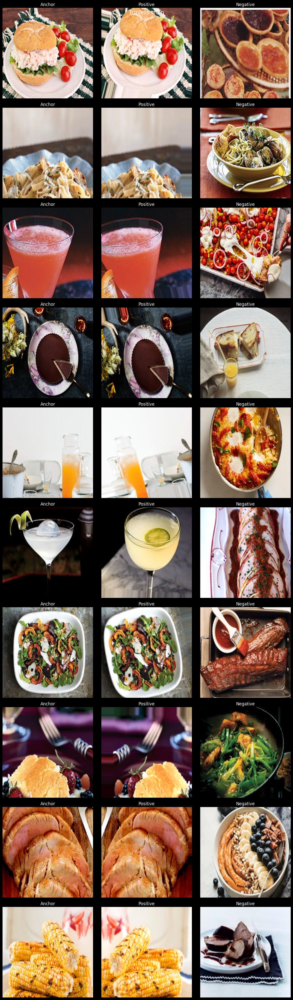

Filtrage des images valides...


Validation images: 100%|██████████| 13463/13463 [00:04<00:00, 3124.26it/s]


13463/13463 images valides
Générateur Validation créé:
- Recettes: 2655
- Images: 2689
- Augmentation: Désactivée
Format du batch triplet: (32, 3, 224, 224, 3)

=== ANALYSE DE LA DIFFICULTÉ DES TRIPLETS ===
Triplet 1:
- Distance anchor-positive: 0.0000
- Distance anchor-negative: 10540.0518
- Ratio difficulté: 1054005175781.25 (FACILE)
Triplet 2:
- Distance anchor-positive: 0.0000
- Distance anchor-negative: 7908.7549
- Ratio difficulté: 790875488281.25 (FACILE)
Triplet 3:
- Distance anchor-positive: 0.0000
- Distance anchor-negative: 11798.2568
- Ratio difficulté: 1179825683593.75 (FACILE)
Triplet 4:
- Distance anchor-positive: 0.0000
- Distance anchor-negative: 15508.2998
- Ratio difficulté: 1550829980468.75 (FACILE)
Triplet 5:
- Distance anchor-positive: 0.0000
- Distance anchor-negative: 8330.0488
- Ratio difficulté: 833004882812.50 (FACILE)

Difficulté moyenne: 1081708242187.50
Évaluation: TRIPLETS TROP FACILES
Image 1-Anchor: min=0.000, max=255.000, mean=84.359
Normalisée: min=0.

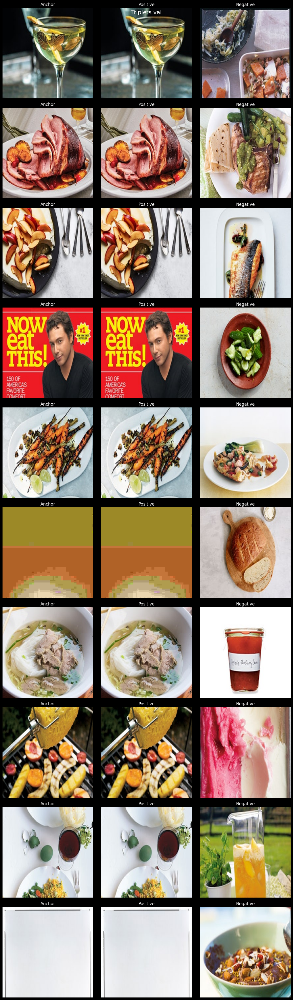

Modèle triplet créé:
- Input shape: (None, 3, 224, 224, 3)
- Output shape: (None, 3, 512)
Modèle phase 2 compilé (entrainement des couches dégelées):
- Optimizer: Adam (lr=1e-05, wd=0.0001)
- Loss: Triplet Loss (margin=0.8)
- Métriques: Accuracy + Similarités moyenne


2025-07-14 20:54:32.884552: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2025-07-14 20:54:32.884581: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
I0000 00:00:1752526472.885298   45902 cupti_tracer.cc:1026] Profiler found 1 GPUs
W0000 00:00:1752526472.953983   45902 cupti_tracer.cc:1213] Fail to use per-thread activity buffer, cupti trace overhead may be big. CUPTI ERROR CODE:1
2025-07-14 20:54:32.954659: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
I0000 00:00:1752526473.152972   45902 cupti_tracer.cc:1249] CUPTI activity buffer flushed


Callbacks configurés pour phase 2:
- Adaptive Margin: initial=0.8
- Early Stopping: patience=3 (val_loss)
- Reduce LR: patience=2, factor=0.5
- Model Checkpoint: best_recipe_image_retrieval_model_ft.keras

DÉBUT DE L'ENTRAÎNEMENT
- Entraînement: 336 batch/époque
- Validation: 84 batch/époque
- Objectif: apprendre des embeddings discriminants via triplet loss

Entraînement phase 2...
Epoch 1/20


2025-07-14 20:55:25.974794: E external/local_xla/xla/stream_executor/cuda/cuda_timer.cc:86] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
2025-07-14 20:55:26.089366: E external/local_xla/xla/stream_executor/cuda/cuda_timer.cc:86] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


  1/336 ━━━━━━━━━━━━━━━━━━━━ 6:19:23 68s/step - average_negative_similarity: 0.0677 - average_positive_similarity: 0.8431 - loss: 0.0651 - triplet_margin_accuracy: 0.5000

2025-07-14 20:55:43.595728: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:103] Profiler session initializing.
2025-07-14 20:55:43.595765: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:118] Profiler session started.
W0000 00:00:1752526543.606135   45902 cupti_tracer.cc:1213] Fail to use per-thread activity buffer, cupti trace overhead may be big. CUPTI ERROR CODE:1
2025-07-14 20:55:43.697338: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:68] Profiler session collecting data.
I0000 00:00:1752526543.941931   45902 cupti_tracer.cc:1249] CUPTI activity buffer flushed


  2/336 ━━━━━━━━━━━━━━━━━━━━ 3:38 655ms/step - average_negative_similarity: 0.0774 - average_positive_similarity: 0.8407 - loss: 0.0740 - triplet_margin_accuracy: 0.4531 

I0000 00:00:1752526544.160300   45902 cupti_collector.cc:793]  GpuTracer has collected 1131 callback api events and 1129 activity events. 
I0000 00:00:1752526544.160550   45902 cupti_collector.cc:796]  GpuTracer max callback_events: 2097152, max activity events: 2097152
2025-07-14 20:55:44.179546: I external/local_tsl/tsl/profiler/lib/profiler_session.cc:130] Profiler session tear down.
2025-07-14 20:55:44.218065: I external/local_xla/xla/tsl/profiler/rpc/client/save_profile.cc:147] Collecting XSpace to repository: ./ft/logs/recipe_image_retrieval_model_ft.keras/train/plugins/profile/2025_07_14_20_55_44/cs-01k053w1y1dk0pbpf3g19yzpn7.xplane.pb


336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 973ms/step - average_negative_similarity: 0.0460 - average_positive_similarity: 0.8283 - loss: 0.0753 - triplet_margin_accuracy: 0.4801
Epoch 1: val_loss improved from inf to 0.01382, saving model to ./ft/best_triplet_recipe_image_retrieval_model_ft.keras
Réduction margin à 0.75

NOUVEAU MEILLEUR MODELE D'EMBEDDINGS sauvegardé!
Fichier: ./ft/best_embedding_recipe_image_retrieval_model_ft.keras
val_loss: 0.0138
336/336 ━━━━━━━━━━━━━━━━━━━━ 451s 1s/step - average_negative_similarity: 0.0459 - average_positive_similarity: 0.8283 - loss: 0.0752 - triplet_margin_accuracy: 0.4802 - val_average_negative_similarity: 0.0056 - val_average_positive_similarity: 0.9910 - val_loss: 0.0138 - val_triplet_margin_accuracy: 0.9096 - learning_rate: 1.0000e-05
Epoch 2/20
336/336 ━━━━━━━━━━━━━━━━━━━━ 0s 879ms/step - average_negative_similarity: 0.0075 - average_positive_similarity: 0.8355 - loss: 0.0541 - triplet_margin_accuracy: 0.5960
Epoch 2: val_loss did not improve from 

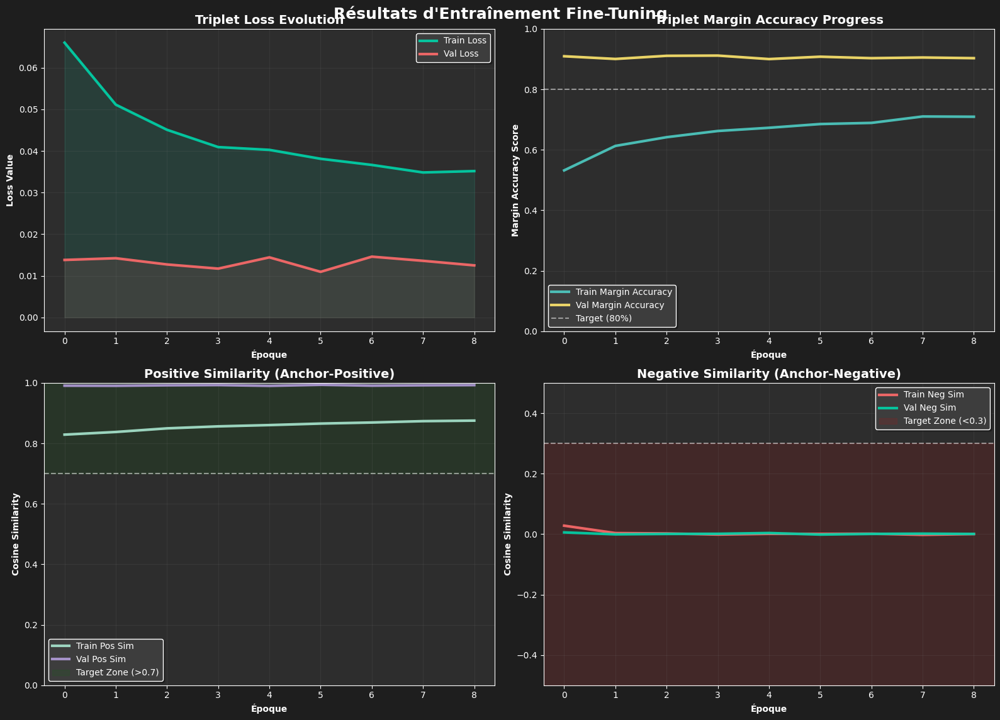


RÉSUMÉ DES MÉTRIQUES FINALES:
--------------------------------------------------
Loss (validation)         : 0.0125
Margin Accuracy (validation) : 0.9033
Similarité Positive       : 0.9929
Similarité Négative       : 0.0005
Écart Pos-Neg             : 0.9924

INTERPRÉTATION:
✅ Excellente accuracy (90.3%)

SUCCÈS! Entraînement terminé.
Modèle prêt: recipe_image_retrieval_model_ft.keras
Prêt pour l'extraction d'embeddings et la recherche par similarité!


In [14]:
# Entraîner la tête uniquement
embedding_model1, history1 = train_transfer_learning_phase1()
# Entraînement des couches dégelées
embedding_model2, history2 = train_fine_tuning_phase2(embedding_model1)

if embedding_model2 is not None and history2 is not None:
    # Afficher les résultats
    plot_training_results(history2)
    
    print("\nSUCCÈS! Entraînement terminé.")
    print(f"Modèle prêt: {CONFIG_FT['MODEL_NAME']}")
    print("Prêt pour l'extraction d'embeddings et la recherche par similarité!")
    
else:
    print("Échec de l'entraînement. Vérifiez les données et ressayez.")

## 5. Création du système de recherche avec la classe RecipeImageRetrievalFT

In [32]:
# PREPROCESSING
def preprocess_image(image_path, img_size=224):
    """Preprocessing robuste avec gestion d'erreurs complète + EfficientNet optimisé"""
    try:
        if not os.path.exists(image_path):
            return None
        
        # Vérifier la taille du fichier (éviter fichiers corrompus)
        if os.path.getsize(image_path) < 1024:  # Moins de 1KB
            return None
        
        img = Image.open(image_path)
        
        # Vérifier si l'image est valide
        img.verify()
        img = Image.open(image_path)  # Recharger après verify
        
        # Convertir en RGB si nécessaire
        if img.mode != 'RGB':
            img = img.convert('RGB')
        
        # Redimensionner avec qualité optimale
        img = img.resize((img_size, img_size), Image.Resampling.LANCZOS)
        
        # Convertir en array et appliquer preprocessing EfficientNet
        img_array = np.array(img, dtype=np.float32)
        img_array = preprocess_input(img_array)  #  Normalisation EfficientNet native
        
        return img_array
        
    except Exception as e:
        return None

#  Note : on remet les couches personnalisées pour ne pas les oublier quand on voudra faire le MLOPS

#  COUCHE L2 NORMALIZATION PERSONNALISÉE (SÉRIALISABLE)
class L2NormalizationLayer(Layer):
    """Couche personnalisée pour normalisation L2 - sérialisable"""
    
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def compute_output_shape(self, input_shape):
        return input_shape
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config

#  COUCHE EXTRACTION TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class ExtractTripletComponent(Layer):
    """Couche pour extraire une composante du triplet"""
    
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def compute_output_shape(self, input_shape):
        # input_shape = (batch_size, 3, height, width, channels)
        return (input_shape[0], input_shape[2], input_shape[3], input_shape[4])
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

#  COUCHE STACK TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class TripletStackLayer(Layer):
    """Couche personnalisée pour empiler les embeddings triplet"""
    
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        # inputs = [anchor_emb, positive_emb, negative_emb]
        return tf.stack(inputs, axis=1)
    
    def compute_output_shape(self, input_shape):
        # input_shape = [(batch_size, embedding_dim), ...]
        batch_size = input_shape[0][0]
        embedding_dim = input_shape[0][1]
        return (batch_size, 3, embedding_dim)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

class RecipeImageRetrievalFT:
    """
    Version Fine-Tuning de RecipeImageRetrievalFT
    Même fonctionnalités, mais avec le modèle FT entraîné
    """

    def __init__(self, model_path=None, recipes_df=None):
        #  Charger le modèle FT
        if model_path is None:
            model_path = './ft/best_embedding_recipe_image_retrieval_model_ft.keras'
        
        #  TRIPLET LOSS OPTIMISÉE POUR EMBEDDINGS NORMALISÉS
        def triplet_loss(margin=0.3):
            """Triplet loss optimisée pour embeddings L2-normalisés"""
            def triplet_loss_fn(y_true, y_pred):
                """
                y_pred contient [anchor, positive, negative] embeddings normalisés
                Utilise distance cosinus (1 - similarity) pour la loss
                """
                anchor = y_pred[:, 0, :]      # (batch_size, embedding_dim)
                positive = y_pred[:, 1, :]    # (batch_size, embedding_dim)
                negative = y_pred[:, 2, :]    # (batch_size, embedding_dim)
                
                # Calcul des distances cosinus (1 - similarité cosinus)
                # Pour embeddings normalisés: cosine_sim = dot_product
                pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
                neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
                
                pos_distance = 1.0 - pos_similarity
                neg_distance = 1.0 - neg_similarity
                
                # Triplet loss: max(0, pos_dist - neg_dist + margin)
                basic_loss = pos_distance - neg_distance + margin
                loss = tf.maximum(0.0, basic_loss)
                
                return tf.reduce_mean(loss)
            
            return triplet_loss_fn
        
        #  MÉTRIQUES
        def triplet_margin_accuracy(y_true, y_pred):
            """% de triplets qui respectent la marge complète (vraie réussite)"""
            anchor = y_pred[:, 0, :]
            positive = y_pred[:, 1, :]
            negative = y_pred[:, 2, :]
            
            pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
            neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
            
            # Distance cosinus
            pos_distance = 1.0 - pos_similarity
            neg_distance = 1.0 - neg_similarity
            
            # Triplet satisfait si : neg_dist - pos_dist > margin
            margin = CONFIG_FT['TRIPLET_MARGIN']  # Utiliser la marge configurée
            margin_satisfied = tf.cast(neg_distance - pos_distance > margin, tf.float32)
            
            return tf.reduce_mean(margin_satisfied)

        def average_positive_similarity(y_true, y_pred):
            """Similarité moyenne anchor-positive"""
            anchor = y_pred[:, 0, :]
            positive = y_pred[:, 1, :]
            pos_similarity = tf.reduce_sum(anchor * positive, axis=1)
            return tf.reduce_mean(pos_similarity)

        def average_negative_similarity(y_true, y_pred):
            """Similarité moyenne anchor-negative"""
            anchor = y_pred[:, 0, :]
            negative = y_pred[:, 2, :]
            neg_similarity = tf.reduce_sum(anchor * negative, axis=1)
            return tf.reduce_mean(neg_similarity)
        
        # Custom objects pour charger correctement le modèle
        custom_objects = {
            'L2NormalizationLayer': L2NormalizationLayer,
            'ExtractTripletComponent': ExtractTripletComponent,
            'TripletStackLayer': TripletStackLayer,
            'triplet_loss': triplet_loss(),
            'triplet_margin_accuracy': triplet_margin_accuracy,
            'average_positive_similarity': average_positive_similarity,
            'average_negative_similarity': average_negative_similarity
        }

        self.model = tf.keras.models.load_model(model_path, 
                                                compile=False,
                                                safe_mode=False,
                                                custom_objects=custom_objects)
        
        print(f"Modèle FT chargé: {model_path}")
        
        # DataFrame
        if recipes_df is None:
            recipes_df = pd.read_pickle("./data/recipes_with_images_dataframe.pkl")
        
        self.recipes_df = recipes_df
        self.embeddings_db = None
        self.image_paths = None
        self.image_to_recipe_map = {}
        
        #  Config
        self.config = CONFIG_FT
        
    def prepare_database(self):
        """IDENTIQUE au notebook raw"""
        print("Préparation de la base de données d'images...")
        
        valid_recipes = self.recipes_df[self.recipes_df['image_path'].notna()].copy()
        self.image_paths = valid_recipes['image_path'].tolist()
        
        for idx, row in valid_recipes.iterrows():
            self.image_to_recipe_map[row['image_path']] = {
                'title': row['Title'],
                'ingredients': row['Ingredients'],
                'instructions': row['Instructions'],
                'original_index': idx
            }
        
        print("Image-to-recipe mapping créé!")
    
    def build_embeddings_database(self, batch_size=32):
        """IDENTIQUE - juste utilise le modèle FT"""
        if self.image_paths is None:
            self.prepare_database()
        
        print("Construction de la base de données d'embeddings...")
        
        embeddings = []
        total_batches = len(self.image_paths) // batch_size + (1 if len(self.image_paths) % batch_size else 0)
        
        for i in range(0, len(self.image_paths), batch_size):
            batch_paths = self.image_paths[i:i+batch_size]
            batch_images = []
            
            print(f"BATCH {i//batch_size + 1}/{total_batches}...")
            
            for img_path in batch_paths:
                try:
                    # Utilise le même preprocessing que FT
                    img_array = preprocess_image(img_path, self.config['IMG_SIZE'])
                    if img_array is not None:
                        batch_images.append(img_array)
                    else:
                        batch_images.append(np.zeros((self.config['IMG_SIZE'], self.config['IMG_SIZE'], 3)))
                except:
                    batch_images.append(np.zeros((self.config['IMG_SIZE'], self.config['IMG_SIZE'], 3)))
            
            if batch_images:
                batch_images = np.array(batch_images)
                batch_embeddings = self.model.predict(batch_images, verbose=0)
              
                ### DEBUT DEBUG POUR VOIR SI LES NORM L2 SONT OK AU CHARGEMENT DU MODELE FT ###
                # Norme d'un embedding individuel
                print(f"Norme 1er embedding: {np.linalg.norm(batch_embeddings[0])}")
                print(f"Normes de tous: {np.linalg.norm(batch_embeddings, axis=1)[:5]}")

                # Vérification moyenne
                mean_norm = np.mean(np.linalg.norm(batch_embeddings, axis=1))
                print(f"Norme moyenne: {mean_norm}")
                ### FIN DEBUG ###

                embeddings.extend(batch_embeddings)
        
        self.embeddings_db = np.array(embeddings)
        print(f"Base de données d'embeddings Fine-Tuning construite: {len(self.embeddings_db)} embeddings")
        print(f"Shape de la base de données d'embeddings: {self.embeddings_db.shape}")


    def visualize_model_architecture(self):
        """Visualisation de l'architecture du modèle Fine-Tuning avec Phase 1 et Phase 2"""
        fig = plt.figure(figsize=(18, 16))
        fig.patch.set_facecolor('#1a1a1a')
        
        fig.suptitle('Architecture du modèle Fine-Tuning - 2 PHASES', 
                    fontsize=20, color='white', fontweight='bold', y=0.96)
        
        total_params = self.model.count_params()
        trainable_params = sum(layer.count_params() for layer in self.model.layers if layer.trainable)
        frozen_params = total_params - trainable_params
        
        total_recipes = len(self.recipes_df)
        recipes_with_images = len(self.recipes_df[self.recipes_df['image_path'].notna()]) if 'image_path' in self.recipes_df.columns else 0
        embeddings_ready = len(self.embeddings_db) if self.embeddings_db is not None else 0
        
        # Distribution des paramètres
        ax1 = plt.subplot(3, 2, 1)
        ax1.set_facecolor('#2d2d2d')
        
        if trainable_params > 0:
            params_data = [frozen_params, trainable_params]
            params_labels = ['Gelés (EfficientNet)', 'Entraînables (40 couches dégelées + Custom Head)']
            colors_params = ['#4ECDC4', '#FF6B9D']
        else:
            params_data = [total_params]
            params_labels = ['Tous gelés']
            colors_params = ['#4ECDC4']
        
        wedges, texts, autotexts = ax1.pie(params_data, labels=params_labels, colors=colors_params, 
                                        autopct='%1.1f%%', startangle=90)
        
        for text in texts:
            text.set_color('white')
        for autotext in autotexts:
            autotext.set_color('white')
            autotext.set_fontweight('bold')
        
        ax1.set_title(f'Distribution des paramètres\nTotal: {total_params:,}', 
                    fontsize=16, color='white', fontweight='bold', pad=20)
        
        # Processus d'entraînement
        ax2 = plt.subplot(3, 2, 2)
        ax2.set_facecolor('#2d2d2d')
        
        ax2.set_xlim(0, 10)
        ax2.set_ylim(0, 6)
        
        # Étapes du processus
        process_steps = [
            (2, 5, "Modèle\nPré-entraîné", '#4ECDC4', 1.5),
            (2, 3, "Phase 1\nTransfer Learning", '#FF6B9D', 1.5),
            (2, 1, "Phase 2\nFine-Tuning", '#45B7D1', 1.5),
            (6, 3, "Modèle\nOptimisé", '#96CEB4', 1.5),
            (8, 3, "Inférence\nRecherche", '#FECA57', 1.5)
        ]
        
        for x, y, text, color, width in process_steps:
            ax2.add_patch(plt.Rectangle((x-width/2, y-0.4), width, 0.8, 
                                    facecolor=color, alpha=0.8, edgecolor='white', linewidth=2))
            ax2.text(x, y, text, ha='center', va='center', fontsize=10, 
                    color='white', fontweight='bold')
        
        arrows = [
            ((2, 4.6), (2, 3.4)),  # Pré-entraîné → Phase 1
            ((2, 2.6), (2, 1.4)),  # Phase 1 → Phase 2
            ((3.5, 1), (4.5, 3)),  # Phase 2 → Modèle optimisé
            ((6.75, 3), (7.25, 3))  # Modèle optimisé → Inférence
        ]
        
        for (x1, y1), (x2, y2) in arrows:
            ax2.annotate('', xy=(x2, y2), xytext=(x1, y1),
                        arrowprops=dict(arrowstyle='->', color='white', lw=2))
        
        ax2.set_title('Processus d\'Entraînement', fontsize=16, color='white', fontweight='bold', pad=20)
        ax2.axis('off')
        
        # PIPELINE PHASE 1 - TRANSFER LEARNING
        ax3 = plt.subplot(3, 2, 3)
        ax3.set_facecolor('#2d2d2d')
        ax3.set_xlim(0, 12)
        ax3.set_ylim(0, 10)  # Plus de hauteur

        # Pipeline Phase 1 - EfficientNet GELÉ
        pipeline_phase1 = [
            (1.5, 6.5, "Image\n224x224x3", '#FF6B9D', 1.5),
            (3.8, 6.5, "EfficientNet\n(GELÉ)", '#4ECDC4', 2.0),
            (6.8, 6.5, "Custom Head\n(ENTRAÎNABLE)", '#FF9F43', 2.0),
            (9.8, 6.5, "Embedding\n512-dim", '#FECA57', 1.6)
        ]

        # Dessiner les étapes Phase 1
        for i, (x, y, text, color, width) in enumerate(pipeline_phase1):
            ax3.add_patch(plt.Rectangle((x-width/2, y-0.9), width, 1.8, 
                                    facecolor=color, alpha=0.8, edgecolor='white', linewidth=2))
            ax3.text(x, y, text, ha='center', va='center', fontsize=10, 
                    color='white', fontweight='bold')
            
            # Flèches entre les étapes
            if i < len(pipeline_phase1) - 1:
                next_x = pipeline_phase1[i+1][0]
                next_width = pipeline_phase1[i+1][4]
                ax3.arrow(x + width/2 + 0.1, y, next_x - x - width/2 - next_width/2 - 0.2, 0, 
                        head_width=0.3, head_length=0.2, fc='white', ec='white', alpha=0.8)

        # Info Phase 1
        ax3.add_patch(plt.Rectangle((0.5, 2.5), 10.5, 2.5, 
                                facecolor='#1a1a1a', alpha=0.9, edgecolor='#FF6B9D', linewidth=2))

        phase1_text = """
        PHASE 1 - TRANSFER LEARNING (6 époques)
        • EfficientNet: TOUTES les couches GELÉES
        • Custom Head: 1280→1024→512 (ENTRAÎNABLE)
        • Learning Rate: 0.001 (élevé pour nouvelles couches)
        • Objectif: Apprendre embeddings spécifiques recettes
        """

        ax3.text(5.75, 3.75, phase1_text, ha='center', va='center', fontsize=10, 
                color='white', fontweight='bold')

        ax3.set_title('PHASE 1: Transfer Learning', fontsize=16, color='#FF6B9D', fontweight='bold', pad=20)
        ax3.text(5.75, 1.0, "Apprentissage des embeddings recettes avec backbone gelé", 
                ha='center', va='center', fontsize=10, color='#FF6B9D', style='italic')
        ax3.axis('off')
        
        # PIPELINE PHASE 2 - FINE-TUNING
        ax4 = plt.subplot(3, 2, 4)
        ax4.set_facecolor('#2d2d2d')
        ax4.set_xlim(0, 12)
        ax4.set_ylim(0, 10)  # Plus de hauteur

        # Pipeline Phase 2 - EfficientNet PARTIELLEMENT DÉGELÉ
        pipeline_phase2 = [
            (1.5, 6.5, "Image\n224x224x3", '#FF6B9D', 1.5),
            (3.8, 6.5, "EfficientNet\n(40 DÉGELÉES)", '#45B7D1', 2.0),
            (6.8, 6.5, "Custom Head\n(ENTRAÎNABLE)", '#FF9F43', 2.0),
            (9.8, 6.5, "Embedding\n512-dim", '#FECA57', 1.6)
        ]

        # Dessiner les étapes Phase 2
        for i, (x, y, text, color, width) in enumerate(pipeline_phase2):
            ax4.add_patch(plt.Rectangle((x-width/2, y-0.9), width, 1.8, 
                                    facecolor=color, alpha=0.8, edgecolor='white', linewidth=2))
            ax4.text(x, y, text, ha='center', va='center', fontsize=10, 
                    color='white', fontweight='bold')
            
            if i < len(pipeline_phase2) - 1:
                next_x = pipeline_phase2[i+1][0]
                next_width = pipeline_phase2[i+1][4]
                ax4.arrow(x + width/2 + 0.1, y, next_x - x - width/2 - next_width/2 - 0.2, 0, 
                        head_width=0.3, head_length=0.2, fc='white', ec='white', alpha=0.8)

        # Info Phase 2
        ax4.add_patch(plt.Rectangle((0.5, 2.5), 10.5, 2.5, 
                                facecolor='#1a1a1a', alpha=0.9, edgecolor='#45B7D1', linewidth=2))

        phase2_text = """
        PHASE 2 - FINE-TUNING (20 époques max)
        • EfficientNet: 40 dernières couches DÉGELÉES
        • Custom Head: reste ENTRAÎNABLE
        • Learning Rate: 0.00001 (faible pour pré-entraîné)
        • Objectif: Fine-tune features visuelles pour recettes
        """

        ax4.text(5.75, 3.75, phase2_text, ha='center', va='center', fontsize=10, 
                color='white', fontweight='bold')

        ax4.set_title('PHASE 2: Fine-Tuning', fontsize=16, color='#45B7D1', fontweight='bold', pad=20)
        ax4.text(5.75, 1.0, "Fine-tuning des features visuelles avec backbone partiellement dégelé", 
                ha='center', va='center', fontsize=10, color='#45B7D1', style='italic')
        ax4.axis('off')
        
        # Statistiques d'entrainement
        ax5 = plt.subplot(3, 2, 5)
        ax5.set_facecolor('#2d2d2d')
        
        training_stats = {
            'Total recettes': total_recipes,
            'Avec\nimages': recipes_with_images,
            'Embeddings FT\nprêts': embeddings_ready,
            'Custom\nDim': self.config['EMBEDDING_DIM_CUSTOM']
        }
        
        bars = ax5.bar(list(training_stats.keys()), list(training_stats.values()),
                    color=['#FF6B9D', '#4ECDC4', '#45B7D1', '#96CEB4'], 
                    alpha=0.9, edgecolor='white', linewidth=2)
        
        ax5.set_title('Statistiques du Fine-Tuning', fontsize=16, color='white', fontweight='bold', pad=20)
        ax5.set_ylabel('Count', fontsize=12, color='white')
        ax5.tick_params(axis='x', labelsize=10, colors='white')
        ax5.tick_params(axis='y', colors='white')
        ax5.grid(True, alpha=0.3, color='#404040')
        
        for bar, value in zip(bars, training_stats.values()):
            ax5.text(bar.get_x() + bar.get_width()/2., bar.get_height() + max(training_stats.values()) * 0.01,
                    f'{value:,}', ha='center', va='bottom', color='white', fontweight='bold')
        
        # Résumé avec les 2 phases
        ax6 = plt.subplot(3, 2, 6)
        ax6.set_facecolor('#2d2d2d')
        ax6.axis('off')

        if embeddings_ready > 0:
            status = "Prêt pour la recherche par similarité"
        elif recipes_with_images > 0:
            status = "Prêt pour extraire les embeddings"
        else:
            status = "Aucune image"

        combined_text = f"""
        RÉSUMÉ DU MODÈLE FINE-TUNING 2 PHASES:
        
        PHASE 1 - TRANSFER LEARNING (6 époques):
        • EfficientNetB0: TOUTES les couches gelées
        • Custom Head: 1280→1024→512 (ENTRAÎNABLE)
        • Learning Rate: {self.config['HEAD_LR']} (élevé pour nouvelles couches)
        • Objectif: Apprendre embeddings spécifiques recettes
        
        PHASE 2 - FINE-TUNING (20 époques max):
        • EfficientNetB0: {self.config['LAYERS_TO_UNFREEZE']} dernières couches DÉGELÉES
        • Custom Head: reste ENTRAÎNABLE
        • Learning Rate: {self.config['BACKBONE_LR']} (faible pour pré-entraîné)
        • Meilleur modèle à l'époque 6
        • Objectif: Fine-tune features visuelles pour recettes
        
        ARCHITECTURE FINALE:
        • Base: EfficientNetB0 (avec poids ImageNet)
        • Dégelées: {self.config['LAYERS_TO_UNFREEZE']} couches
        • Custom Head: 1280→1024→512 (avec L2 norm)
        • Fonction de loss: Triplet Loss (margin={self.config['TRIPLET_MARGIN']})
        • Régularisation: Dropout ({self.config['DROPOUT_RATE']})
        • Triplet generator qui fait du hard negative sampling
        
        PARAMÈTRES:
        • Total: {total_params:,}
        • Gelés: {frozen_params:,} ({frozen_params/total_params*100:.1f}%)
        • Entraînables: {trainable_params:,} ({trainable_params/total_params*100:.1f}%)

        Custom Layers (Serializable):
        • L2NormalizationLayer: Normalisation L2
        • ExtractTripletComponent: Extraction des triplets (Random Sampling pour la negative)
        • TripletStackLayer: Stack des embeddings pour le loss
        • Toutes les couches sont compatibles avec la sauvegarde et le chargement du modèle

        CALLBACKS D'ENTRAÎNEMENT:
        • AdaptiveMarginCallback: Margin adaptatif
        • EarlyStopping: Patience {self.config['PATIENCE']}
        • ReduceLROnPlateau: Factor {self.config['REDUCE_LR_FACTOR']}
        • EmbeddingModelCheckpoint: Sauvegarde embedding model (et non le triplet model)
        
        PERFORMANCES ATTENDUES:
        • Phase 1: Apprentissage embeddings recettes (triplet_margin_accuracy: ~85%)
        • Phase 2: Fine-tuning features visuelles (triplet_margin_accuracy: ~90%+)
        • Temps total: ~1-2 heures
        • Meilleure compréhension sémantique des recettes
        
        STATUT: {status}
        Dataset: {total_recipes:,} recettes, {recipes_with_images:,} avec images
        """

        ax6.text(0.05, 0.95, combined_text, transform=ax6.transAxes, fontsize=8.5, 
                color='white', verticalalignment='top', fontfamily='monospace',
                bbox=dict(boxstyle="round,pad=0.5", facecolor='#2d2d2d', alpha=0.8))
        
        plt.tight_layout(pad=3.0, rect=[0, 0.02, 1, 0.94])
        plt.show()
        
        print("\n" + "="*80)
        print("DÉTAILS DU FINE-TUNING 2 PHASES:")
        print("="*80)
        print(f"PHASE 1 - TRANSFER LEARNING:")
        print(f"• EfficientNetB0: TOUTES les couches gelées")
        print(f"• Custom Head: 1280→1024→512 (ENTRAÎNABLE)")
        print(f"• Learning Rate: {self.config['HEAD_LR']} (élevé)")
        print(f"• Epochs: {self.config['HEAD_EPOCHS']}")
        print(f"")
        print(f"PHASE 2 - FINE-TUNING:")
        print(f"• EfficientNetB0: {self.config['LAYERS_TO_UNFREEZE']} dernières couches DÉGELÉES")
        print(f"• Custom Head: reste ENTRAÎNABLE")
        print(f"• Learning Rate: {self.config['BACKBONE_LR']} (faible)")
        print(f"• Epochs: {self.config['BACKBONE_EPOCHS']}")
        print(f"")
        print(f"TOTAL:")
        print(f"• Paramètres totaux: {total_params:,}")
        print(f"• Paramètres gelés: {frozen_params:,} ({frozen_params/total_params*100:.1f}%)")
        print(f"• Paramètres entraînables: {trainable_params:,} ({trainable_params/total_params*100:.1f}%)")
        print(f"• Architecture finale: EfficientNetB0 + Fine-Tuning 2 phases (512D)")

    def search_similar_recipes(self, query_image_path, top_k=3):
        """IDENTIQUE - utilise cosine similarity"""
        if self.embeddings_db is None:
            print("Il faut d'abord construire la base de données d'embeddings!")
            return None
        
        print(f"Recherche des {top_k} recette similaires avec le modèle de Fine-Tuning...")
        
        try:
            #  Même preprocessing que FT
            img_array = preprocess_image(query_image_path, self.config['IMG_SIZE'])
            if img_array is None:
                raise Exception("Impossible de charger l'image")
            
            img_array = np.expand_dims(img_array, axis=0)
            query_embedding = self.model.predict(img_array, verbose=0)
        except Exception as e:
            print(f"Erreur lors du chargement de l'image: {e}")
            return None
        
        # Calcul similarité cosinus
        similarities = cosine_similarity(query_embedding, self.embeddings_db)[0]
      
        # Get top-k similaires
        top_indices = np.argsort(similarities)[::-1][:top_k]
        
        results = []
        for rank, idx in enumerate(top_indices):
            img_path = self.image_paths[idx]
            similarity_score = similarities[idx]
            
            if img_path in self.image_to_recipe_map:
                recipe_info = self.image_to_recipe_map[img_path].copy()
                recipe_info['rank'] = rank + 1
                recipe_info['similarity'] = similarity_score
                recipe_info['similar_image_path'] = img_path
                results.append(recipe_info)
    
        return results
    
    def display_results(self, query_image_path, results):
        """IDENTIQUE - même visualisation"""
        if not results:
            print("Aucun résultat")
            return
        
        fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 6))
        fig.patch.set_facecolor('#1a1a1a')
        fig.suptitle('IMAGE → TOP 3 RECETTES SIMILAIRES (Fine-Tuning)', 
                     fontsize=18, color='white', fontweight='bold', y=0.95)
        
        colors = ['#FF6B9D', '#4ECDC4', '#45B7D1', '#96CEB4']
        
        try:
            query_img = Image.open(query_image_path)
            axes[0].imshow(query_img)
            axes[0].set_title("INPUT", fontsize=14, color=colors[0], fontweight='bold', pad=15)
            axes[0].axis('off')
            
            for spine in axes[0].spines.values():
                spine.set_visible(True)
                spine.set_color(colors[0])
                spine.set_linewidth(3)
        except:
            axes[0].text(0.5, 0.5, " Query image\nnot found", ha='center', va='center',
                        transform=axes[0].transAxes, color='white', fontsize=12)
        
        for i, result in enumerate(results):
            try:
                result_img = Image.open(result['similar_image_path'])
                axes[i+1].imshow(result_img)
                
                title = result['title'][:25] + "..." if len(result['title']) > 25 else result['title']
                similarity = result['similarity']
                
                axes[i+1].set_title(f"#{result['rank']}: {title}\n TL Similarity: {similarity:.3f}", 
                                   fontsize=12, color=colors[i+1], fontweight='bold', pad=15)
                axes[i+1].axis('off')
                
                for spine in axes[i+1].spines.values():
                    spine.set_visible(True)
                    spine.set_color(colors[i+1])
                    spine.set_linewidth(3)
                    
            except:
                axes[i+1].text(0.5, 0.5, f"Image #{result['rank']}\nintrouvable", 
                              ha='center', va='center', transform=axes[i+1].transAxes, 
                              color='white', fontsize=11)
        
        plt.tight_layout()
        plt.show()
        
        print("\n" + "="*80)
        print("RECETTES SIMILAIRES (Fine-Tuning)")
        print("="*80)
        
        for result in results:
            print(f"\nRANG #{result['rank']}: {result['similarity']:.4f}")
            print(f"{result['title']}")
            print("-" * 60)
            
            ingredients = str(result['ingredients'])
            if len(ingredients) > 300:
                ingredients = ingredients[:300] + "..."
            print(f"Ingredients:\n{ingredients}")
            print("-" * 60)
            
            instructions = str(result['instructions'])
            if len(instructions) > 400:
                instructions = instructions[:400] + "..."
            print(f"Instructions:\n{instructions}")
            print("=" * 80)
    
    def test_with_random_image(self, top_k=3):
        """IDENTIQUE"""
        if not self.image_paths:
            print("Aucune image disponible pour le test")
            return
        
        random_idx = np.random.randint(0, len(self.image_paths))
        test_image_path = self.image_paths[random_idx]
        
        print(f"Test avec l'image: {test_image_path}")
        
        results = self.search_similar_recipes(test_image_path, top_k)
        
        if results:
            self.display_results(test_image_path, results)
        else:
            print("Aucun résultat")

print("RecipeImageRetrievalFT créée!")
print("Utilisation:")
print("- retrieval_ft = RecipeImageRetrievalFT()")
print("- retrieval_ft.build_embeddings_database()")
print("- retrieval_ft.visualize_model_architecture()")
print("- retrieval_ft.test_with_random_image()")
print("- retrieval_ft.search_similar_recipes(test_image_path, top_k)")

RecipeImageRetrievalFT créée!
Utilisation:
- retrieval_ft = RecipeImageRetrievalFT()
- retrieval_ft.build_embeddings_database()
- retrieval_ft.visualize_model_architecture()
- retrieval_ft.test_with_random_image()
- retrieval_ft.search_similar_recipes(test_image_path, top_k)


## 6. Extraction des embeddings avec le nouveau modèle !

In [20]:
# ÉTAPE 1: vérifier le modèle FT
model_tl_path = './ft/best_embedding_recipe_image_retrieval_model_ft.keras'
if os.path.exists(model_tl_path):
    print(f"Modèle FT trouvé: {model_tl_path}")
else:
    print(f"Modèle FT non trouvé: {model_tl_path}")
    print("Veuillez d'abord exécuter les cellules d'entraînement pour créer le modèle FT")

# ÉTAPE 2: vérifier DataFrame
data_path = "./data/recipes_with_images_dataframe.pkl"
if os.path.exists(data_path):
    try:
        recipes_df = pd.read_pickle(data_path)
        print(f"DataFrame chargée avec {len(recipes_df)} recettes")
    except Exception as e:
        print(f"Erreur dans le chargement du DataFrame: {e}")
        recipes_df = None
else:
    print(f"DataFrame introuvable: {data_path}")
    print("Veuillez d'abord exécuter le notebook 'recipe_image_retrieval_raw.ipynb' pour créer le DataFrame")
    recipes_df = None

# ÉTAPE 3: Initialiser le système FT
if os.path.exists(model_tl_path) and recipes_df is not None:
    print("\nInitialisation du système de recherche par similarité avec Fine-Tuning...")
    
    # Chargement du modèle FT
    try:
        print("Le modèle FT a été chargé avec succès!")
        
        # Initialiser le système de retrieval FT
        retrieval_system_ft = RecipeImageRetrievalFT(model_tl_path, recipes_df)
        
        # Préparer la base de données
        retrieval_system_ft.prepare_database()
        
        print("Le système de recherche par similarité avec Fine-Tuning a été initialisé avec succès!")
        print(f"La base de données contient {len(retrieval_system_ft.image_paths)} images")
        
        print(f"\n Détails du modèle FT:")
        print(f"- Input shape: {retrieval_system_ft.model.input_shape}")
        print(f"- Output shape: {retrieval_system_ft.model.output_shape}")
        print(f"- Embedding dim: {CONFIG_FT['EMBEDDING_DIM_CUSTOM']}")
        print(f"- Entraînement: Triplet Loss optimisé")
        
    except Exception as e:
        print(f"Erreur dans le chargement du modèle FT: {e}")
        print("Vérifiez si toutes les couches personnalisées sont correctement définies")
        retrieval_system_ft = None
        
else:
    print("Impossible d'initialiser le système de recherche par similarité avec Fine-Tuning!")
    print("Fichiers manquants ou incorrects.")
    retrieval_system_ft = None

#  ÉTAPE 4: construire la base de données d'embeddings TL
if retrieval_system_ft is not None:
    print("\nConstruction de la base de données d'embeddings avec Fine-Tuning...")
    print("Cela peut prendre quelques minutes...")
    
    # Batch size adapté pour TL
    retrieval_system_ft.build_embeddings_database(batch_size=CONFIG_FT['BATCH_SIZE'])
    
    print("\nLe système de recherche par similarité avec Fine-Tuning est prêt!")
    print(f" {len(retrieval_system_ft.embeddings_db)} embeddings générés")
    print(f"Shape embeddings: {retrieval_system_ft.embeddings_db.shape}")
    
    tl_embeddings_path = f"./ft/{CONFIG_FT['EMBEDDINGS_NAME']}"
    tl_metadata_path = f"./ft/{CONFIG_FT['METADATA_NAME']}"
    
    np.save(tl_embeddings_path, retrieval_system_ft.embeddings_db)
    
    with open(tl_metadata_path, 'wb') as f:
        pickle.dump({
            'image_paths': retrieval_system_ft.image_paths,
            'image_to_recipe_map': retrieval_system_ft.image_to_recipe_map,
            'config': CONFIG_FT
        }, f)
    
    print(f"Embeddings sauvegardés: {tl_embeddings_path}")
    print(f"Metadonnées sauvegardés: {tl_metadata_path}")
    
    print("\nProchaines étapes:")
    print("1. Tester avec une image aléatoire: retrieval_system_ft.test_with_random_image()")
    print("2. Rechercher avec votre propre image: retrieval_system_ft.search_similar_recipes('path/to/image.jpg')")
    print("3. Comparer avec les résultats avec le modèle raw")

else:
    print("\nSystème de recherche par similarité avec Fine-Tuning n'est pas initialisé.")
    print("Dépannage:")
    print("1. Vérifiez que vous avez exécuté les cellules d'entraînement FT")
    print("2. Vérifiez que les couches personnalisées sont bien définies")
    print("3. Vérifiez que le fichier du modèle existe")
    print("4. Vérifiez que le DataFrame des recettes est disponible")

Modèle FT trouvé: ./ft/best_embedding_recipe_image_retrieval_model_ft.keras
DataFrame chargée avec 13463 recettes

Initialisation du système de recherche par similarité avec Fine-Tuning...
Le modèle FT a été chargé avec succès!
Modèle FT chargé: ./ft/best_embedding_recipe_image_retrieval_model_ft.keras
Préparation de la base de données d'images...
Image-to-recipe mapping créé!
Le système de recherche par similarité avec Fine-Tuning a été initialisé avec succès!
La base de données contient 13463 images

 Détails du modèle FT:
- Input shape: (None, 224, 224, 3)
- Output shape: (None, 512)
- Embedding dim: 512
- Entraînement: Triplet Loss optimisé

Construction de la base de données d'embeddings avec Fine-Tuning...
Cela peut prendre quelques minutes...
Construction de la base de données d'embeddings...
BATCH 1/421...
Norme 1er embedding: 0.9999999403953552
Normes de tous: [1. 1. 1. 1. 1.]
Norme moyenne: 1.0
BATCH 2/421...
Norme 1er embedding: 0.9999999403953552
Normes de tous: [0.99999994

## 7. Initialisation du système et visualisations du modèle TL

Chargement du système sauvegardé...
 Embeddings loaded: (13463, 512)
 Metadata loaded
 Recipes DataFrame loaded: 13463 recipes
Modèle FT chargé: ./ft/best_embedding_recipe_image_retrieval_model_ft.keras
Système chargé avec 13,463 embeddings!

Visualisation de l'architecture du modèle...


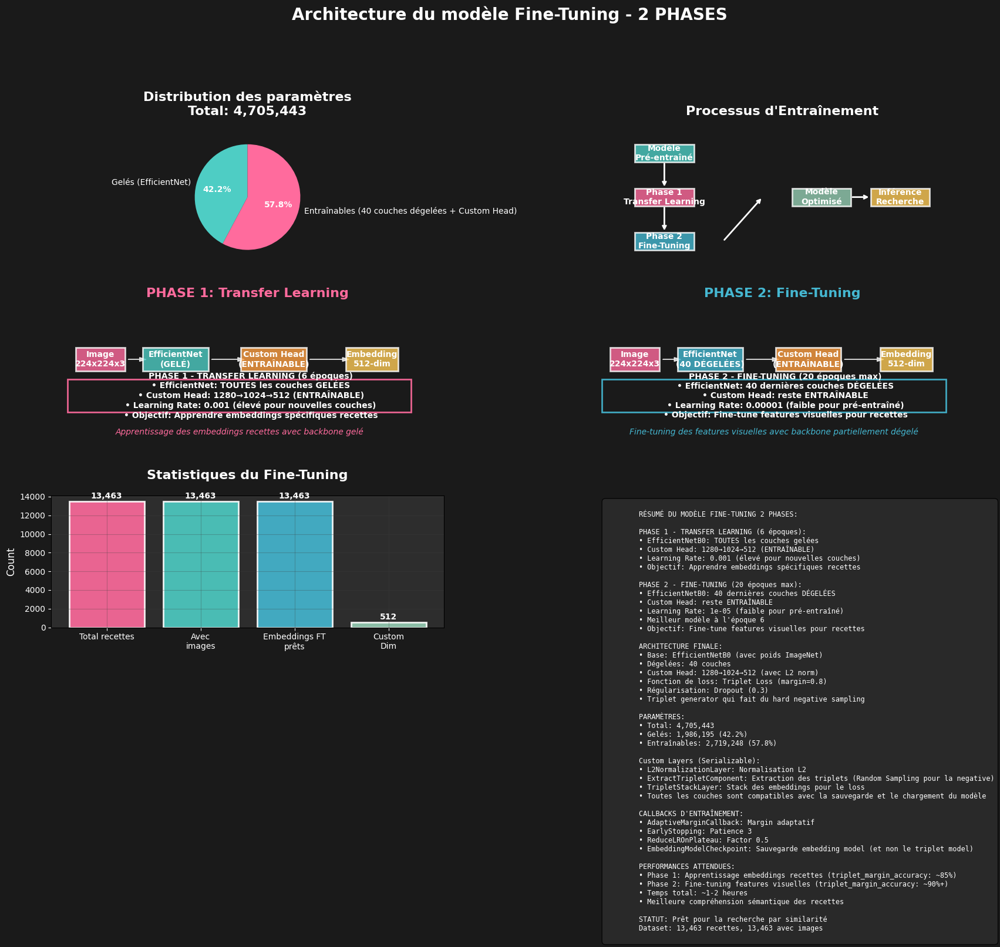


DÉTAILS DU FINE-TUNING 2 PHASES:
PHASE 1 - TRANSFER LEARNING:
• EfficientNetB0: TOUTES les couches gelées
• Custom Head: 1280→1024→512 (ENTRAÎNABLE)
• Learning Rate: 0.001 (élevé)
• Epochs: 6

PHASE 2 - FINE-TUNING:
• EfficientNetB0: 40 dernières couches DÉGELÉES
• Custom Head: reste ENTRAÎNABLE
• Learning Rate: 1e-05 (faible)
• Epochs: 20

TOTAL:
• Paramètres totaux: 4,705,443
• Paramètres gelés: 1,986,195 (42.2%)
• Paramètres entraînables: 2,719,248 (57.8%)
• Architecture finale: EfficientNetB0 + Fine-Tuning 2 phases (512D)


In [33]:
# Si possible, on recharge le système depuis les fichiers sauvegardés => parfait pour préparer le déploiement

import tensorflow as tf
import pickle
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
from tensorflow.keras.layers import Layer

#  COUCHE L2 NORMALIZATION PERSONNALISÉE (SÉRIALISABLE)
class L2NormalizationLayer(Layer):
    """Couche personnalisée pour normalisation L2 - sérialisable"""
    
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def compute_output_shape(self, input_shape):
        return input_shape
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config
    
#  COUCHE EXTRACTION TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class ExtractTripletComponent(Layer):
    """Couche pour extraire une composante du triplet"""
    
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def compute_output_shape(self, input_shape):
        # input_shape = (batch_size, 3, height, width, channels)
        return (input_shape[0], input_shape[2], input_shape[3], input_shape[4])
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

#  COUCHE STACK TRIPLET PERSONNALISÉE (SÉRIALISABLE)
class TripletStackLayer(Layer):
    """Couche personnalisée pour empiler les embeddings triplet"""
    
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        # inputs = [anchor_emb, positive_emb, negative_emb]
        return tf.stack(inputs, axis=1)
    
    def compute_output_shape(self, input_shape):
        # input_shape = [(batch_size, embedding_dim), ...]
        batch_size = input_shape[0][0]
        embedding_dim = input_shape[0][1]
        return (batch_size, 3, embedding_dim)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

CONFIG_STANDALONE = {
    'IMG_SIZE': 224,
}

# On essaie de charger le système sauvegardé
print("Chargement du système sauvegardé...")
    
try:
    # Chargement bdd embeddings
    embeddings_db = np.load("./ft/recipe_embeddings_database_ft.npy")
    print(f" Embeddings loaded: {embeddings_db.shape}")
    
    # Chargement métadonnées
    with open("./ft/recipe_embeddings_database_metadata_ft.pkl", 'rb') as f:
        metadata = pickle.load(f)
    print(" Metadata loaded")
    
    # Chargement DataFrame
    recipes_df_path = "./data/recipes_with_images_dataframe.pkl"
    if os.path.exists(recipes_df_path):
        recipes_with_images = pd.read_pickle(recipes_df_path)
        print(f" Recipes DataFrame loaded: {len(recipes_with_images)} recipes")
    else:
        print(" recipes_with_images_dataframe_tl.pkl not found!")
        print(" Please save the DataFrame first using:")
        print("   recipes_with_images.to_pickle('recipes_with_images_dataframe.pkl')")
     
    # Création du système
    retrieval_system_ft = RecipeImageRetrievalFT()
    retrieval_system_ft.embeddings_db = embeddings_db
    retrieval_system_ft.image_paths = metadata['image_paths']
    retrieval_system_ft.image_to_recipe_map = metadata['image_to_recipe_map']
    
    print(f"Système chargé avec {len(embeddings_db):,} embeddings!")
   
except FileNotFoundError as e:
    print(f"Fichier introuvable: {e}")
    print("Veuillez vérifier que ces fichiers existent:")
    print("- recipe_image_retrieval_model_ft.keras (ou dans le dossier ./models/)")
    print("- recipe_embeddings_database_ft.npy")
    print("- recipe_embeddings_database_metadata_ft.pkl")
    print("- recipes_with_images_dataframe.pkl")
   
except Exception as e:
    print(f" Error loading system: {e}")
    import traceback
    traceback.print_exc()
    
print("\nVisualisation de l'architecture du modèle...")
retrieval_system_ft.visualize_model_architecture()

## 8. Test de recherche sur une image aléatoire du dataset


Test avec une image aléatoire de la base de données...
Test avec l'image: /teamspace/studios/this_studio/.cache/kagglehub/datasets/pes12017000148/food-ingredients-and-recipe-dataset-with-images/versions/1/Food Images/Food Images/cran-royale.jpg
Recherche des 3 recette similaires avec le modèle de Fine-Tuning...


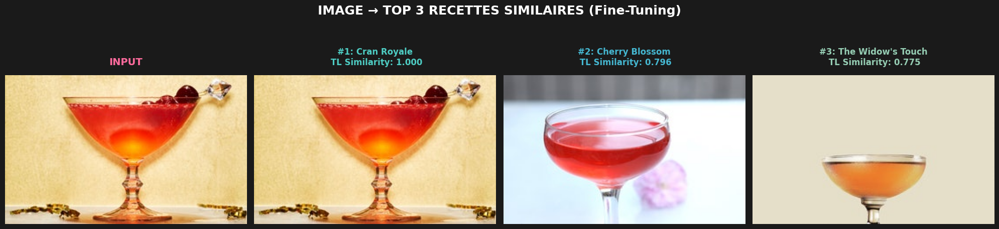


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 1.0000
Cran Royale
------------------------------------------------------------
Ingredients:
['6 sprigs thyme', '1 cup fresh or frozen cranberries', '1/4 cup sugar', '2 ounces fresh lemon juice', '1 ounce Campari', '12 ounces Champagne or dry sparkling wine', 'Fresh cranberries (for serving)']
------------------------------------------------------------
Instructions:
Cook thyme, cranberries, sugar, and 1/4 cup water in a small saucepan over low, swirling pan occasionally, just until sugar is dissolved and cranberries have released their color, 12–15 minutes (do not reduce liquid). Strain through a fine-mesh sieve into a heatproof bowl or measuring cup and let cool (you should have 4 oz.).
For each cocktail, combine 1 oz. cranberry-thyme syrup, 1/2 oz. lemon ju...

RANG #2: 0.7964
Cherry Blossom
------------------------------------------------------------
Ingredients:
['1 ounce cherry brandy', '1 ounce brandy', '1/ 4 teaspoon curaçao', '1/4 t

In [26]:
print("\nTest avec une image aléatoire de la base de données...")
retrieval_system_ft.test_with_random_image(top_k=3)

## 9. Recherche sur des images inconnues du système

Chargement du système Fine-Tuning...
Modèle FT chargé: ./ft/best_embedding_recipe_image_retrieval_model_ft.keras
Système chargé avec 13,463 embeddings!

TEST IMAGE 1.jpg (Fine-Tuning)
Recherche des 3 recette similaires avec le modèle de Fine-Tuning...


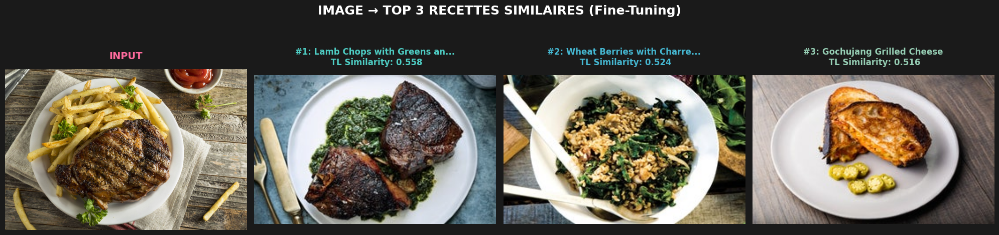


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.5581
Lamb Chops with Greens and Sorrel Salsa Verde
------------------------------------------------------------
Ingredients:
['8 1 1/2-2"-thick lamb loin chops (about 3 pounds)', 'Kosher salt, freshly ground pepper', '2/3 cup sorrel or spinach leaves', '1/3 cup mint leaves', '1/3 cup parsley leaves', '1 tablespoon finely grated lemon zest', '1 teaspoon crushed red pepper flakes', '5 garlic cloves, thinly sliced, divided',...
------------------------------------------------------------
Instructions:
Pat lamb dry; season with salt and pepper. Let sit at room temperature 1 hour.
Meanwhile, puree sorrel, mint, parsley, lemon zest, red pepper flakes, about 1 garlic clove, and 1/3 cup oil in a blender, scraping down sides as needed, until mixture is smooth. Season salsa verde with salt and pepper; set aside.
Prepare grill for high heat (or heat a grill pan over high). Grill chops, turning every 2 ...

RANG #2: 0.5240
Wheat Berries with Charred O

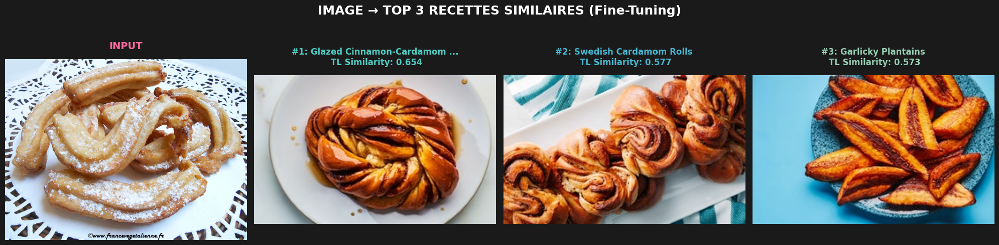


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.6545
Glazed Cinnamon-Cardamom Buns
------------------------------------------------------------
Ingredients:
['1 cup whole milk', '1 Tbsp. active dry yeast', '1 large egg', '1 large egg yolk', '3 1/2 cups (475 g) all-purpose flour', '1/2 cup (105 g) granulated sugar', '1 1/2 tsp. (3 g) ground cardamom', '1 tsp. kosher salt', '6 Tbsp. room temperature unsalted butter, plus more for bowl', '6 Tbsp. unsalted ...
------------------------------------------------------------
Instructions:
Heat milk in a small saucepan over low until just warm; an instant-read thermometer should register 105°F–115°F. Pour into the large bowl of a stand mixer. Whisk in yeast and let sit until foamy, 10–15 minutes. You should see a layer of foam on the surface; this means that the yeast is active.
Add egg, egg yolk, flour, granulated sugar, cardamom, and salt to yeast mixture and mix with dough hook o...

RANG #2: 0.5769
Swedish Cardamom Rolls
---------------------

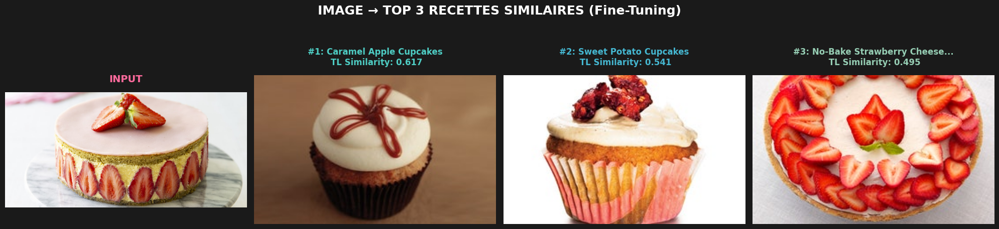


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.6165
Caramel Apple Cupcakes
------------------------------------------------------------
Ingredients:
['2 1/2 cups all-purpose flour', '3 tsp. baking powder', '1 tsp. ground cinnamon', '1/2 tsp. salt', '16 Tbsp. unsalted butter, at room temperature (European style recommended)', '2 cups sugar', '4 large eggs, at room temperature', '1/3 cup hot water', '2 1/2 cups freshly grated apples (4 to 5 medium...
------------------------------------------------------------
Instructions:
Preheat the oven to 350°F. Line a standard cupcake pan with twelve paper baking cups, and a second pan with six baking cups, or grease pans with butter if not using baking cups.
Sift together the flour, baking powder, cinnamon, and salt on a sheet of parchment paper or wax paper and set aside.
Place the butter in the bowl of a stand mixer or in a bowl with a handheld electric mixer. Beat on medium...

RANG #2: 0.5406
Sweet Potato Cupcakes
-----------------------------

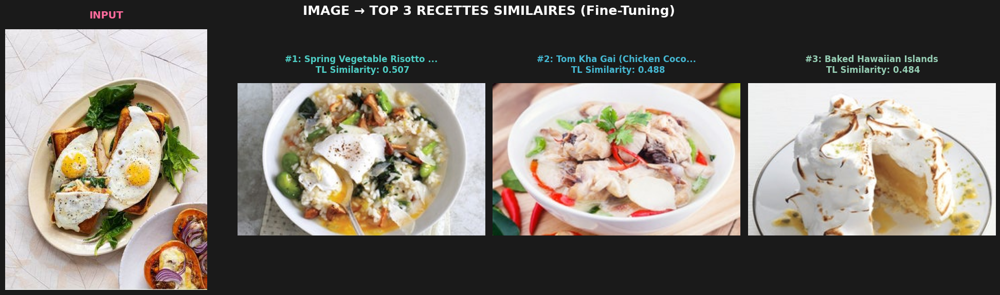


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.5068
Spring Vegetable Risotto with Poached Eggs
------------------------------------------------------------
Ingredients:
['2 cups shelled fresh (or frozen, thawed) fava beans or peas (from about 2 pounds pods)', 'Kosher salt', '1 tablespoon distilled white vinegar', '6 large eggs', '8 cups low-sodium chicken broth', '2 tablespoons unsalted butter, divided', '1/4 pound chanterelles or crimini (baby bella) mushrooms, ha...
------------------------------------------------------------
Instructions:
If using fresh fava beans, cook in a large saucepan of boiling salted water 1 minute. Drain; transfer to a bowl of ice water and let cool. Peel favas and transfer to a small bowl.
Bring a large skillet of salted water to a bare simmer over medium-low heat. Add vinegar. Crack 1 egg into a small bowl, then slide into simmering water. Repeat with 2 more eggs. Cook until whites are cooked but yolks ar...

RANG #2: 0.4877
Tom Kha Gai (Chicken Coconut So

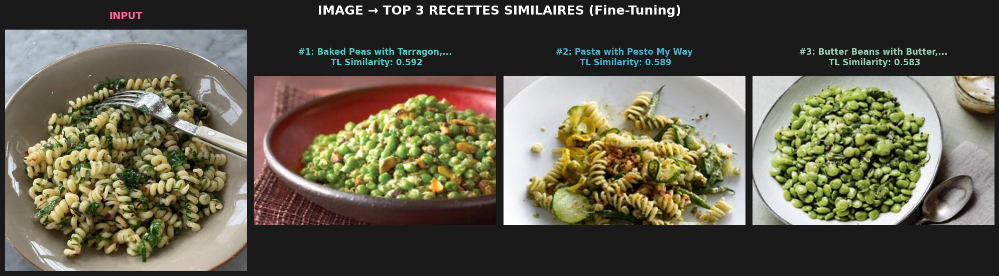


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.5920
Baked Peas with Tarragon, Yogurt, and Pistachios
------------------------------------------------------------
Ingredients:
['1 pound frozen baby peas', '1/2 cup loosely packed fresh tarragon leaves', '2 scallions, white and green parts, chopped', '2 tablespoons extra-virgin olive oil', '1/4 cup Greek yogurt', '1/2 cup chopped pistachios']
------------------------------------------------------------
Instructions:
Preheat the oven to 500˚F. Put the peas in a clay pot or a small Dutch oven and gently heat them on the stove until they thaw, stirring occasionally.
Meanwhile, put the tarragon, scallions, olive oil, yogurt, and ¼ cup of the pistachios into a blender and puree. Gently mix into the peas, sprinkle the top with extra chopped pistachios, and bake for about 15 minutes—about the time the top will begin...

RANG #2: 0.5885
Pasta with Pesto My Way
------------------------------------------------------------
Ingredients:
['2 medium zu

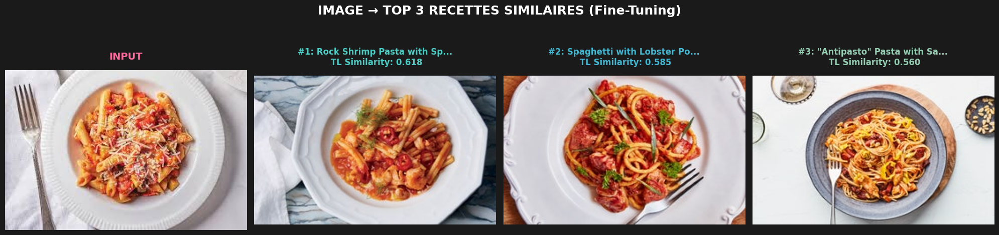


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.6177
Rock Shrimp Pasta with Spicy Tomato Sauce
------------------------------------------------------------
Ingredients:
['1 (28-ounce) can whole peeled tomatoes, preferably San Marzano, drained', '1/3 cup olive oil, plus more for drizzling', '1/2 medium fennel bulb, fronds reserved, core removed, bulb thinly sliced', '8 garlic cloves, smashed', '1 Fresno chile, very thinly sliced, divided', '1/4 cup dry white wine', ...
------------------------------------------------------------
Instructions:
Set a fine-mesh sieve over a medium bowl. Working over sieve, squeeze tomatoes to release juices and break up flesh. Let tomatoes drain in sieve, collecting juices in bowl, until ready to use.
Heat 1/3 cup oil in a large Dutch oven or other heavy pot over medium. Cook fennel, garlic, and half of chile, stirring often, until garlic is golden and fennel is starting to brown around the edges, 5–8 min...

RANG #2: 0.5847
Spaghetti with Lobster Pomodoro


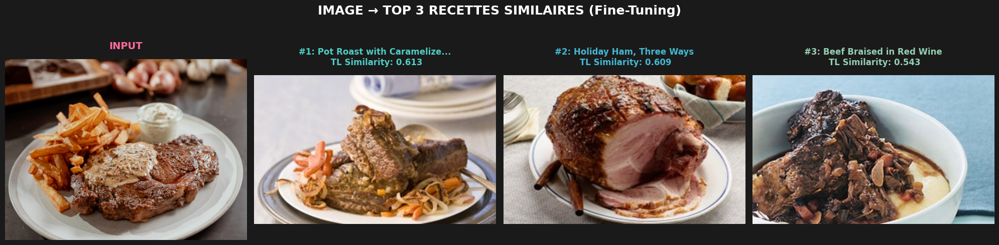


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.6129
Pot Roast with Caramelized Onions and Roasted Carrots
------------------------------------------------------------
Ingredients:
['1/2 cup canola oil', 'Kosher salt and freshly ground black pepper', '5 pounds boneless short ribs, denuded (all surface fat removed; have your butcher do this)', '1 cup dry sherry', '4 carrots, peeled and roughly chopped', '2 large onions, peeled and roughly chopped', '8 stalks celery, peeled and ...
------------------------------------------------------------
Instructions:
Position racks in upper and lower thirds of oven and preheat to 350°F. Season beef liberally with salt and pepper. In large Dutch oven or heavy ovenproof pot over moderately high heat, heat oil until hot but not smoking. Add beef and sear until dark brown and crisp on both sides, about 10 minutes total. Transfer beef to large plate. Pour off oil in pan and discard. Add sherry and simmer uncovered,...

RANG #2: 0.6089
Holiday Ham, Three W

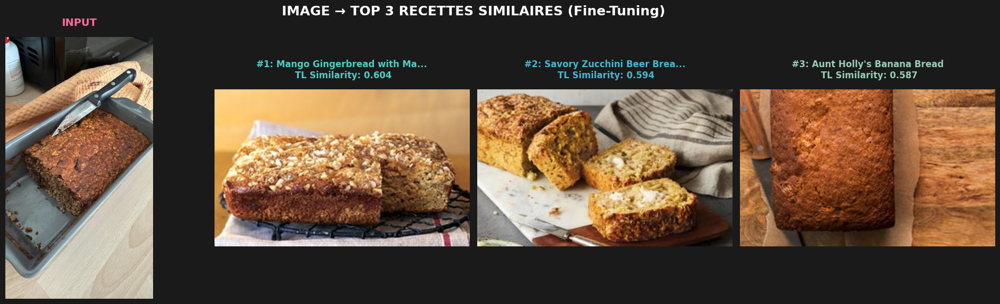


RECETTES SIMILAIRES (Fine-Tuning)

RANG #1: 0.6041
Mango Gingerbread with Macadamia Streusel
------------------------------------------------------------
Ingredients:
['1/3 cup finely chopped lightly salted dry-roasted macadamia nuts', '1/4 cup sugar', '2 1/2 tablespoons finely chopped crystallized ginger', '2 cups all purpose flour', '3/4 cup (packed) golden brown sugar', '1 1/2 tablespoons ground ginger', '2 teaspoons baking powder', '1 teaspoon baking soda', '...
------------------------------------------------------------
Instructions:
Stir all ingredients in small bowl to blend.
Position rack in center of oven and preheat to 350°F. Butter 9x9x2-inch metal baking pan. Whisk first 6 ingredients in medium bowl to blend. Coarsely puree mangoes in food processor. Transfer 1 cup mango puree to large bowl (reserve any remaining puree for another use). Add buttermilk, oil, and eggs to puree; whisk until blended. Add flour mixture; stir...

RANG #2: 0.5945
Savory Zucchini Beer Bread
-----

In [34]:
import tensorflow as tf
import numpy as np
import os
import pickle
import pandas as pd

# Custom layers pour TL (nécessaires pour le chargement)
class L2NormalizationLayer(tf.keras.layers.Layer):
    def __init__(self, axis=1, **kwargs):
        super(L2NormalizationLayer, self).__init__(**kwargs)
        self.axis = axis
    
    def call(self, inputs):
        return tf.nn.l2_normalize(inputs, axis=self.axis)
    
    def get_config(self):
        config = super(L2NormalizationLayer, self).get_config()
        config.update({'axis': self.axis})
        return config

class ExtractTripletComponent(tf.keras.layers.Layer):
    def __init__(self, component_index, **kwargs):
        super(ExtractTripletComponent, self).__init__(**kwargs)
        self.component_index = component_index
    
    def call(self, inputs):
        return inputs[:, self.component_index]
    
    def get_config(self):
        config = super(ExtractTripletComponent, self).get_config()
        config.update({'component_index': self.component_index})
        return config

class TripletStackLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super(TripletStackLayer, self).__init__(**kwargs)
    
    def call(self, inputs):
        return tf.stack(inputs, axis=1)
    
    def get_config(self):
        return super(TripletStackLayer, self).get_config()

print("Chargement du système Fine-Tuning...")

try:
    # Chargement bdd embeddings
    embeddings_db = np.load("./ft/recipe_embeddings_database_ft.npy")
    
    # Chargement métadonnées
    with open("./ft/recipe_embeddings_database_metadata_ft.pkl", 'rb') as f:
        metadata = pickle.load(f)
    
    # Chargement DataFrame
    recipes_with_images = pd.read_pickle("./data/recipes_with_images_dataframe.pkl")
    
    # Création du système
    retrieval_system_ft = RecipeImageRetrievalFT()
    retrieval_system_ft.embeddings_db = embeddings_db
    retrieval_system_ft.image_paths = metadata['image_paths']
    retrieval_system_ft.image_to_recipe_map = metadata['image_to_recipe_map']
    
    print(f"Système chargé avec {len(embeddings_db):,} embeddings!")
    
except FileNotFoundError:
    print("Aucun système sauvegardé trouvé.")
    retrieval_system_ft = None
except Exception as e:
    print(f"Erreur: {e}")
    retrieval_system_ft = None

if retrieval_system_ft and retrieval_system_ft.embeddings_db is not None:
    # Test sur les images 1.jpg à 8.jpg
    for i in range(1, 9):
        test_image = f"./test_recipes/{i}.jpg"
        
        if os.path.exists(test_image):
            print(f"\n{'='*50}")
            print(f"TEST IMAGE {i}.jpg (Fine-Tuning)")
            print(f"{'='*50}")
            
            results = retrieval_system_ft.search_similar_recipes(test_image, top_k=3)
            if results:
                retrieval_system_ft.display_results(test_image, results)
            else:
                print("Aucun résultat trouvé")
        else:
            print(f"Image {i}.jpg introuvable")
    
else:
    print("Système non disponible")